### Problem Statement

A US-based housing company named Surprise Housing has decided to enter the Australian market.

The company uses data analytics to purchase houses at a price below their actual values and flip them on at a higher price.
For the same purpose, the company has collected a data set from the sale of houses in Australia.

The company is looking at prospective properties to buy to enter the market

Build a regression model using regularisation in order to predict the actual value of the prospective properties and decide whether to invest in them or not.

The company wants to know:
- Which variables are significant in predicting the price of a house
- How well those variables describe the price of a house.

Determine the optimal value of lambda for ridge and lasso regression.


### Business Goal 

Model the price of houses with the available independent variables.

This model will then be used by the management to understand how exactly the prices vary with the variables. 

They can accordingly manipulate the strategy of the firm and concentrate on areas that will yield high returns. Further, the model will be a good way for management to understand the pricing dynamics of a new market.

### Importing necessary libraries

In [1]:
# Importing all required packages
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import math
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.feature_selection import RFE
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import make_pipeline
from sklearn.metrics import mean_squared_error, r2_score
%matplotlib inline

# Supress Warnings
import warnings
warnings.filterwarnings('ignore')



## Step 1: Reading and Understanding the Data

Let's start with the following steps:

1. Importing data using the pandas library
2. Understanding the structure of the data

In [2]:
# Data loading
#Importing dataset
housing_df = pd.read_csv('train.csv')

In [3]:
# Set display options to show all rows, columns
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
%matplotlib inline

In [4]:
# Data understanding
# Print first 5 datapoints
housing_df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [5]:
# Understand the shape of the dataset
housing_df.shape

# Note: Dataset has 1460 rows and 81 columns

(1460, 81)

In [6]:
# Fetch the information about the dataset
housing_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

In [7]:
# Gain the statistic info about the dataset.
# Will delve into each features in later point of time
housing_df.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.000000,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1379.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,730.500000,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,46.549315,567.240411,1057.429452,1162.626712,346.992466,5.844521,1515.463699,0.425342,0.057534,1.565068,0.382877,2.866438,1.046575,6.517808,0.613014,1978.506164,1.767123,472.980137,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,2007.815753,180921.195890
std,421.610009,42.300571,24.284752,9981.264932,1.382997,1.112799,30.202904,20.645407,181.066207,456.098091,161.319273,441.866955,438.705324,386.587738,436.528436,48.623081,525.480383,0.518911,0.238753,0.550916,0.502885,0.815778,0.220338,1.625393,0.644666,24.689725,0.747315,213.804841,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,1.328095,79442.502883
min,1.000000,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,334.000000,0.000000,0.000000,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,1900.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,365.750000,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,0.000000,223.000000,795.750000,882.000000,0.000000,0.000000,1129.500000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,5.000000,0.000000,1961.000000,1.000000,334.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,730.500000,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,0.000000,477.500000,991.500000,1087.000000,0.000000,0.000000,1464.000000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,6.000000,1.000000,1980.000000,2.000000,480.000000,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,1095.250000,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,0.000000,808.000000,1298.250000,1391.250000,728.000000,0.000000,1776.750000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,7.000000,1.000000,2002.000000,2.000000,576.000000,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,1474.000000,2336.000000,6110.000000,4692.000000,2065.000000,572.000000,5642.000000,3.000000,2.000000,3.000000,2.000000,8.000000,3.000000,14.000000,3.000000,2010.000000,4.000000,1418.000000,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


#### Data cleaning 

#### Fix Rows and Cloumns
    Incorrect rows - None (no header rows, footer rows)
    Missing Column Names - None (Column names as blanks, NA, XX etc)
    Inconsistent column names - None
    Misaligned columns - None

In [8]:
# Find the columns having null values in percentage
(100*housing_df.isnull().mean()).sort_values(ascending=False)

PoolQC           99.520548
MiscFeature      96.301370
Alley            93.767123
Fence            80.753425
FireplaceQu      47.260274
LotFrontage      17.739726
GarageYrBlt       5.547945
GarageCond        5.547945
GarageType        5.547945
GarageFinish      5.547945
GarageQual        5.547945
BsmtFinType2      2.602740
BsmtExposure      2.602740
BsmtQual          2.534247
BsmtCond          2.534247
BsmtFinType1      2.534247
MasVnrArea        0.547945
MasVnrType        0.547945
Electrical        0.068493
Id                0.000000
Functional        0.000000
Fireplaces        0.000000
KitchenQual       0.000000
KitchenAbvGr      0.000000
BedroomAbvGr      0.000000
HalfBath          0.000000
FullBath          0.000000
BsmtHalfBath      0.000000
TotRmsAbvGrd      0.000000
GarageCars        0.000000
GrLivArea         0.000000
GarageArea        0.000000
PavedDrive        0.000000
WoodDeckSF        0.000000
OpenPorchSF       0.000000
EnclosedPorch     0.000000
3SsnPorch         0.000000
S

In [9]:
# Addressing the missing values by understanding the data for the above features 

# From the data dictionary, its observed that features having values NA can be considered as not present

# Categorical Features with missing values shall be replaced with NA.
# Example: In the feature, PoolQC: Pool quality. NA means No Pool

In [10]:
# Following Categorical Features with missing values shall be replaced with NA.
cat_cols = ['PoolQC', 'MiscFeature', 'Alley', 'Fence', 'FireplaceQu', 'GarageCond', 'GarageType', 'GarageFinish', 'GarageQual', 
           'BsmtFinType2', 'BsmtExposure', 'BsmtQual', 'BsmtCond', 'BsmtFinType1']

In [11]:
# Value counts before handling missing values in categorical features
for i in cat_cols:
    print(housing_df[i].value_counts())

Gd    3
Ex    2
Fa    2
Name: PoolQC, dtype: int64
Shed    49
Gar2     2
Othr     2
TenC     1
Name: MiscFeature, dtype: int64
Grvl    50
Pave    41
Name: Alley, dtype: int64
MnPrv    157
GdPrv     59
GdWo      54
MnWw      11
Name: Fence, dtype: int64
Gd    380
TA    313
Fa     33
Ex     24
Po     20
Name: FireplaceQu, dtype: int64
TA    1326
Fa      35
Gd       9
Po       7
Ex       2
Name: GarageCond, dtype: int64
Attchd     870
Detchd     387
BuiltIn     88
Basment     19
CarPort      9
2Types       6
Name: GarageType, dtype: int64
Unf    605
RFn    422
Fin    352
Name: GarageFinish, dtype: int64
TA    1311
Fa      48
Gd      14
Ex       3
Po       3
Name: GarageQual, dtype: int64
Unf    1256
Rec      54
LwQ      46
BLQ      33
ALQ      19
GLQ      14
Name: BsmtFinType2, dtype: int64
No    953
Av    221
Gd    134
Mn    114
Name: BsmtExposure, dtype: int64
TA    649
Gd    618
Ex    121
Fa     35
Name: BsmtQual, dtype: int64
TA    1311
Gd      65
Fa      45
Po       2
Name: BsmtCond,

In [12]:
# Replace missing values with NA
for i in cat_cols:
    housing_df[i].fillna('NA', inplace=True)

In [13]:
# Value counts after handling missing values in categorical features
for i in cat_cols:
    print(housing_df[i].value_counts())

NA    1453
Gd       3
Ex       2
Fa       2
Name: PoolQC, dtype: int64
NA      1406
Shed      49
Gar2       2
Othr       2
TenC       1
Name: MiscFeature, dtype: int64
NA      1369
Grvl      50
Pave      41
Name: Alley, dtype: int64
NA       1179
MnPrv     157
GdPrv      59
GdWo       54
MnWw       11
Name: Fence, dtype: int64
NA    690
Gd    380
TA    313
Fa     33
Ex     24
Po     20
Name: FireplaceQu, dtype: int64
TA    1326
NA      81
Fa      35
Gd       9
Po       7
Ex       2
Name: GarageCond, dtype: int64
Attchd     870
Detchd     387
BuiltIn     88
NA          81
Basment     19
CarPort      9
2Types       6
Name: GarageType, dtype: int64
Unf    605
RFn    422
Fin    352
NA      81
Name: GarageFinish, dtype: int64
TA    1311
NA      81
Fa      48
Gd      14
Ex       3
Po       3
Name: GarageQual, dtype: int64
Unf    1256
Rec      54
LwQ      46
NA       38
BLQ      33
ALQ      19
GLQ      14
Name: BsmtFinType2, dtype: int64
No    953
Av    221
Gd    134
Mn    114
NA     38
Name:

In [14]:
# Addressing null values for the remaining features
(100*housing_df.isnull().mean()).sort_values(ascending=False)

LotFrontage      17.739726
GarageYrBlt       5.547945
MasVnrType        0.547945
MasVnrArea        0.547945
Electrical        0.068493
KitchenQual       0.000000
GarageType        0.000000
FireplaceQu       0.000000
Fireplaces        0.000000
Functional        0.000000
TotRmsAbvGrd      0.000000
Id                0.000000
GarageFinish      0.000000
BedroomAbvGr      0.000000
HalfBath          0.000000
FullBath          0.000000
BsmtHalfBath      0.000000
BsmtFullBath      0.000000
GrLivArea         0.000000
LowQualFinSF      0.000000
2ndFlrSF          0.000000
KitchenAbvGr      0.000000
GarageCars        0.000000
GarageArea        0.000000
PoolQC            0.000000
SaleCondition     0.000000
SaleType          0.000000
YrSold            0.000000
MoSold            0.000000
MiscVal           0.000000
MiscFeature       0.000000
Fence             0.000000
PoolArea          0.000000
GarageQual        0.000000
ScreenPorch       0.000000
3SsnPorch         0.000000
EnclosedPorch     0.000000
O

In [15]:
# Impute missing values for LotFrontage (Approx 18% has missing values)

In [16]:
housing_df["LotFrontage"].dtype

dtype('float64')

In [17]:
housing_df["LotFrontage"].describe()

count    1201.000000
mean       70.049958
std        24.284752
min        21.000000
25%        59.000000
50%        69.000000
75%        80.000000
max       313.000000
Name: LotFrontage, dtype: float64

In [18]:
# It has been observed from describe() that mean and median are almost same and hence missing values can be imputed by median
median = housing_df['LotFrontage'].median()
housing_df['LotFrontage'].fillna(median, inplace=True)

In [19]:
# From the list of missing values it has been observed that % of missing values in Garage realted features are same (5.5%). 
# Other Garage related categorical features are marked as NA. Similarly, GarageYrBlt shall be imputed with 0
housing_df['GarageYrBlt'].fillna(0, inplace=True)

In [20]:
# Removing missing value data from MasVnrArea, Electrical features because missing value % is very low
housing_df.dropna(subset=['MasVnrArea'], inplace=True)
housing_df.dropna(subset=['Electrical'], inplace=True)

In [21]:
# Feature MasVnrType has missing value approx 0.5%. From the Data dict it can be observed that NA sub-category isn't there.
# None sub-category is already present and hence missing values shall be removed.
housing_df['MasVnrType'].value_counts()

None       863
BrkFace    445
Stone      128
BrkCmn      15
Name: MasVnrType, dtype: int64

In [22]:
housing_df.dropna(subset=['MasVnrType'], inplace=True)

In [23]:
# Rechecking the missing values. 
(100*housing_df.isnull().mean()).sort_values(ascending=False)

# Note: No missing values observed

Id               0.0
CentralAir       0.0
GarageYrBlt      0.0
GarageType       0.0
FireplaceQu      0.0
Fireplaces       0.0
Functional       0.0
TotRmsAbvGrd     0.0
KitchenQual      0.0
KitchenAbvGr     0.0
BedroomAbvGr     0.0
HalfBath         0.0
FullBath         0.0
BsmtHalfBath     0.0
BsmtFullBath     0.0
GrLivArea        0.0
LowQualFinSF     0.0
2ndFlrSF         0.0
1stFlrSF         0.0
GarageFinish     0.0
GarageCars       0.0
GarageArea       0.0
PoolQC           0.0
SaleCondition    0.0
SaleType         0.0
YrSold           0.0
MoSold           0.0
MiscVal          0.0
MiscFeature      0.0
Fence            0.0
PoolArea         0.0
GarageQual       0.0
ScreenPorch      0.0
3SsnPorch        0.0
EnclosedPorch    0.0
OpenPorchSF      0.0
WoodDeckSF       0.0
PavedDrive       0.0
GarageCond       0.0
Electrical       0.0
HeatingQC        0.0
MSSubClass       0.0
Heating          0.0
OverallCond      0.0
OverallQual      0.0
HouseStyle       0.0
BldgType         0.0
Condition2   

In [24]:
# Rechecking the shape
housing_df.shape

(1451, 81)

In [25]:
# Find the rows having null values
len(housing_df[housing_df.isnull().any(axis=1)])

# Inference: No null rows were found

0

#### Duplicates check

In [26]:

# Check if there are any duplicate rows
len(housing_df[housing_df.duplicated()])

# No duplicate rows found

0

In [27]:
housing_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1451 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1451 non-null   int64  
 1   MSSubClass     1451 non-null   int64  
 2   MSZoning       1451 non-null   object 
 3   LotFrontage    1451 non-null   float64
 4   LotArea        1451 non-null   int64  
 5   Street         1451 non-null   object 
 6   Alley          1451 non-null   object 
 7   LotShape       1451 non-null   object 
 8   LandContour    1451 non-null   object 
 9   Utilities      1451 non-null   object 
 10  LotConfig      1451 non-null   object 
 11  LandSlope      1451 non-null   object 
 12  Neighborhood   1451 non-null   object 
 13  Condition1     1451 non-null   object 
 14  Condition2     1451 non-null   object 
 15  BldgType       1451 non-null   object 
 16  HouseStyle     1451 non-null   object 
 17  OverallQual    1451 non-null   int64  
 18  OverallC

In [28]:
# Select features of data type integer or float
numeric_features = housing_df.select_dtypes(include=['int', 'float']).columns

In [29]:
numeric_features

Index(['Id', 'MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual',
       'OverallCond', 'YearBuilt', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1',
       'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF',
       'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd',
       'Fireplaces', 'GarageYrBlt', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea',
       'MiscVal', 'MoSold', 'YrSold', 'SalePrice'],
      dtype='object')

In [30]:
# From the Data dict analysis, it has been observed that following numeric features have categorical data and hence these can be converted to categorical.
housing_df['MSSubClass'] = housing_df['MSSubClass'].astype('object')
housing_df['OverallQual'] = housing_df['OverallQual'].astype('object')
housing_df['OverallCond'] = housing_df['OverallCond'].astype('object')

In [31]:
housing_df['MSSubClass'].dtype

dtype('O')

In [32]:
housing_df['OverallQual'].dtype

dtype('O')

In [33]:
housing_df['OverallCond'].dtype

dtype('O')

In [34]:
housing_df['OverallCond'].value_counts()

5    814
6    251
7    205
8     72
4     57
3     24
9     22
2      5
1      1
Name: OverallCond, dtype: int64

In [35]:
# Based on initial analysis, we can remove 'id'column which does not add relevance in analysis
housing_df.drop('Id', axis=1, inplace=True)

### Outliers check

In [36]:
def visualize_numerical_outliers(df):
    numerical_features = housing_df.select_dtypes(include=['number']).columns
    for feature in numerical_features:
        ax = sns.boxplot(x=df[feature])
        # Rotate x-axis labels
        ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
        plt.show()

In [37]:
def visualize_categorical_distribution(df):
    categorical_features = df.select_dtypes(exclude=['number']).columns
    for feature in categorical_features:
        ax = sns.countplot(x=df[feature])
        # Rotate x-axis labels
        ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
        plt.show()

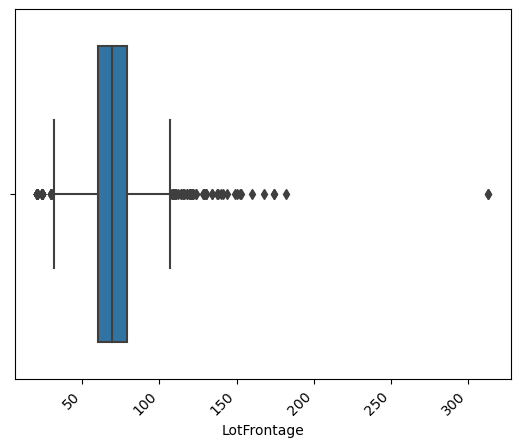

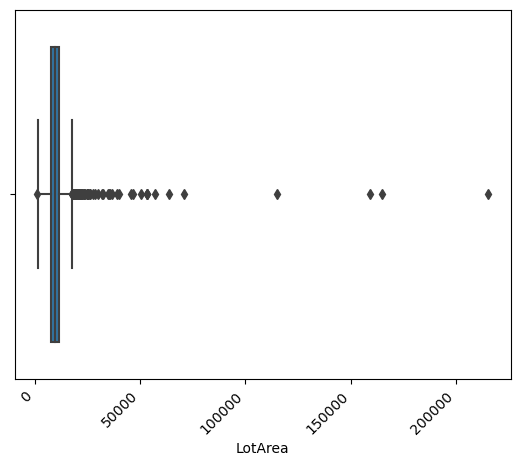

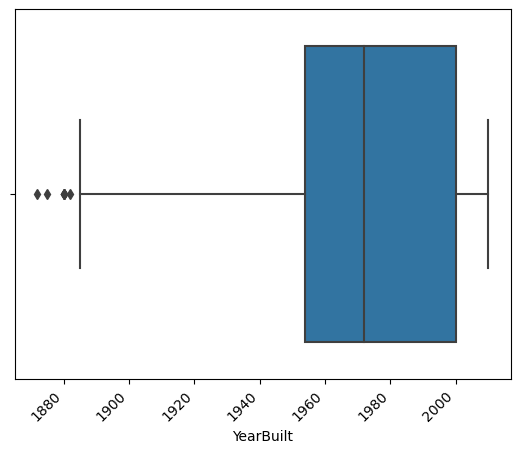

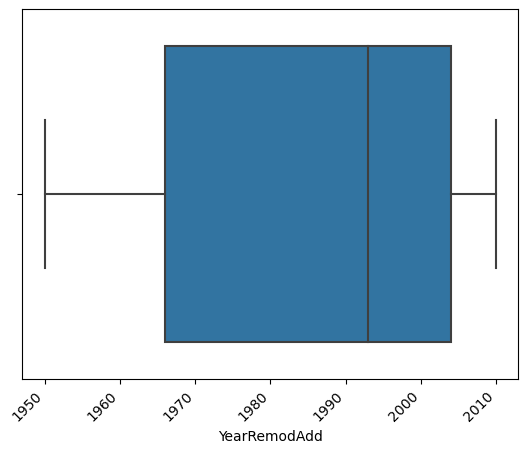

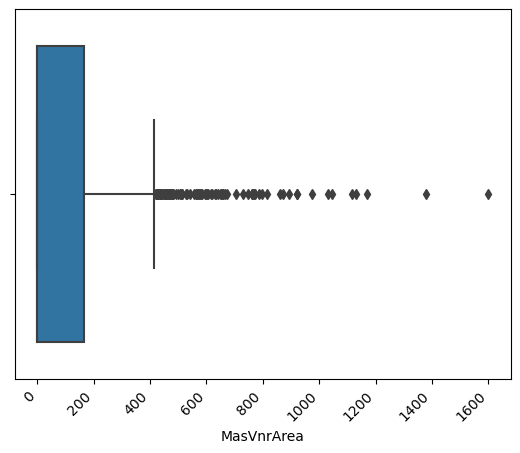

...

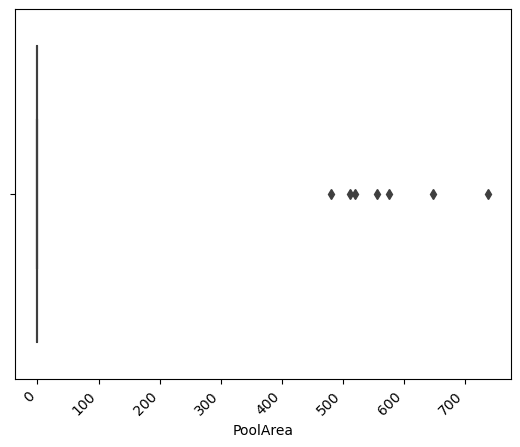

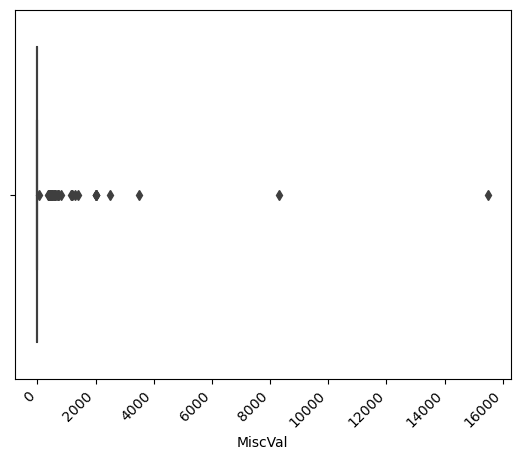

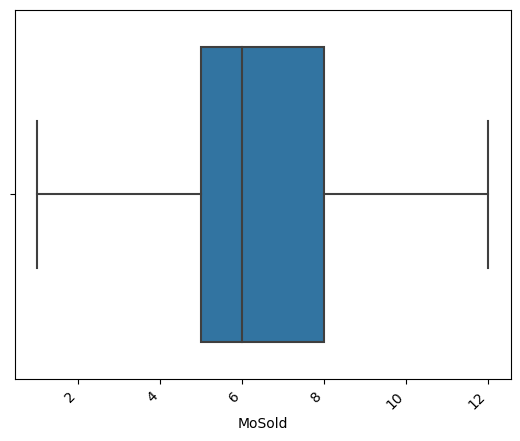

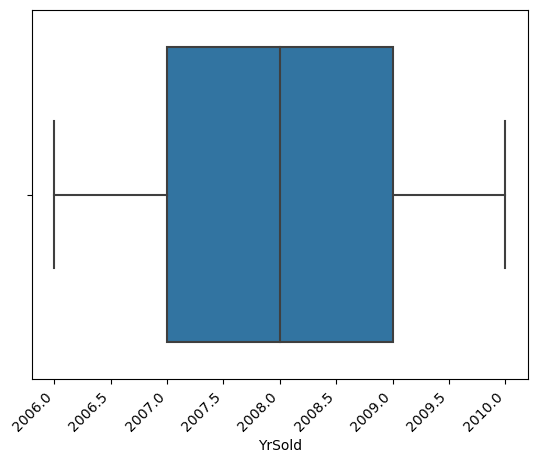

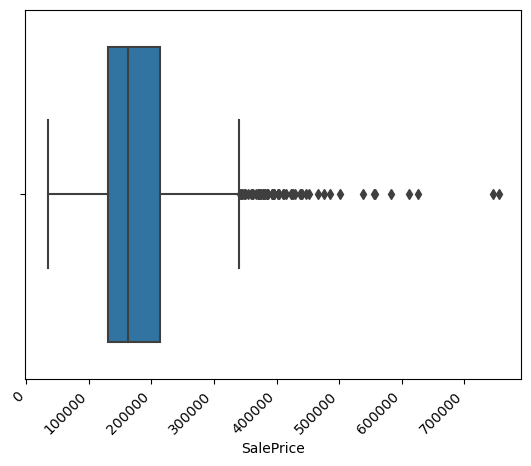

In [38]:
visualize_numerical_outliers(housing_df)

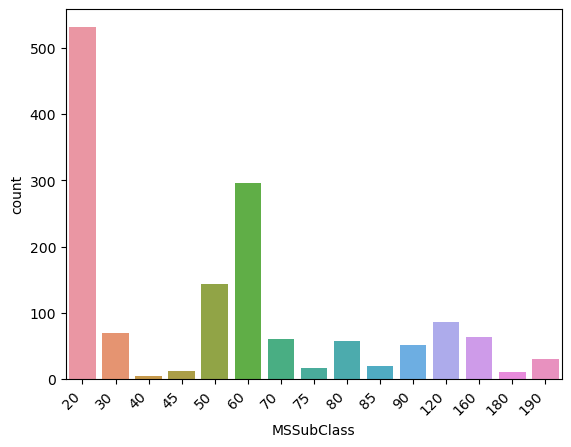

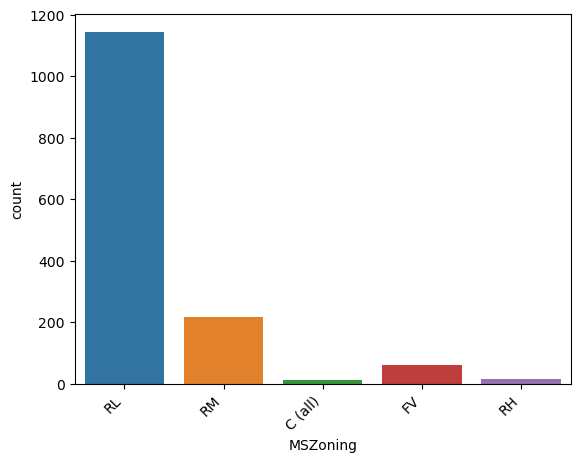

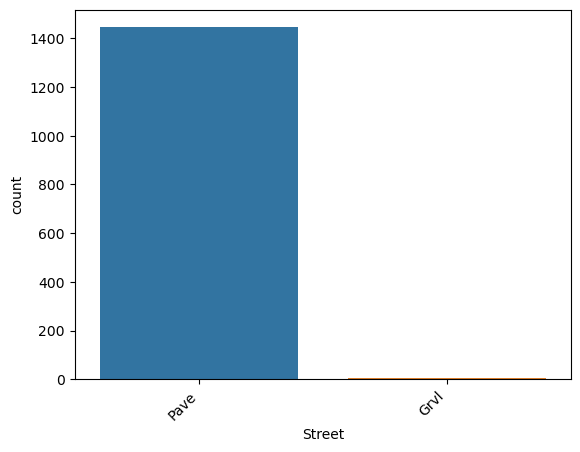

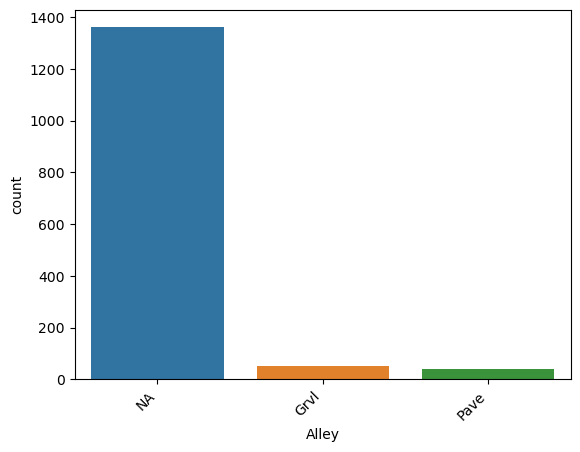

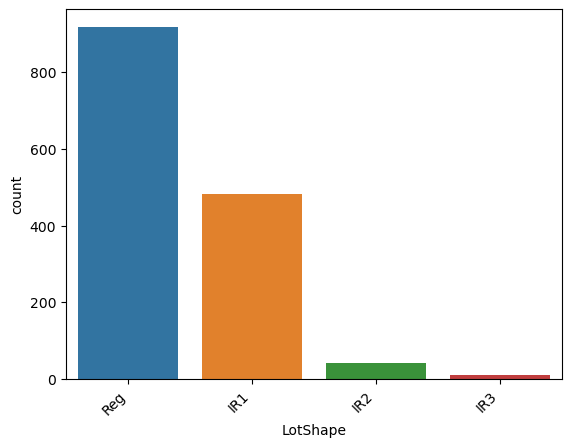

...

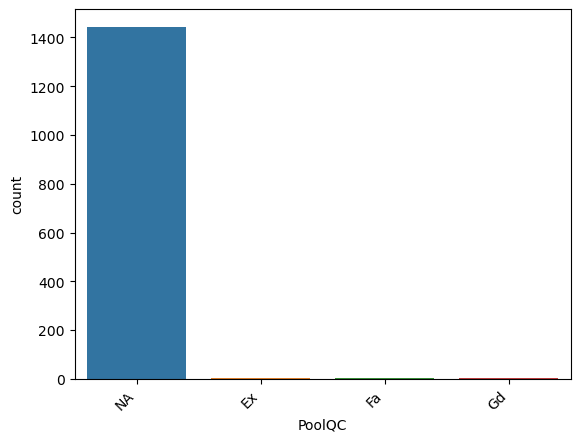

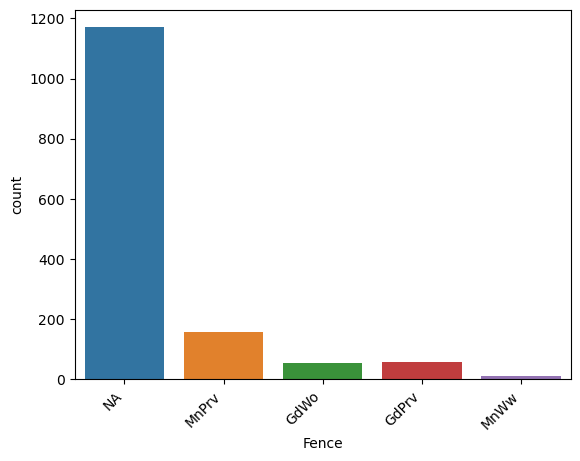

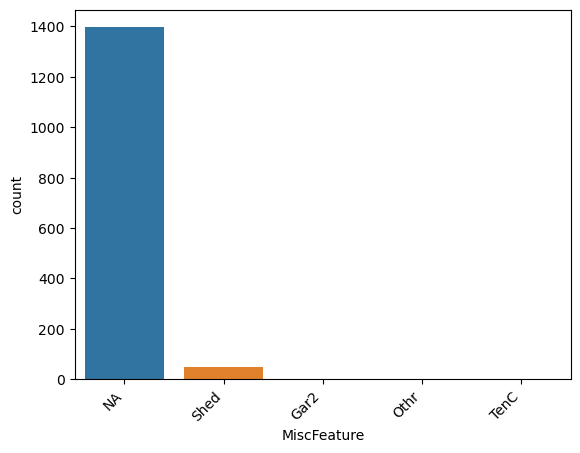

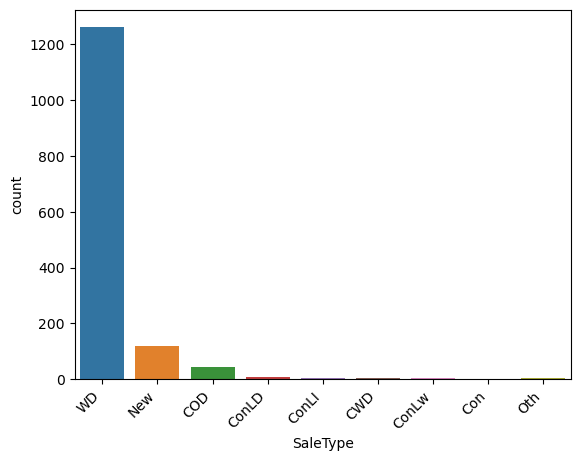

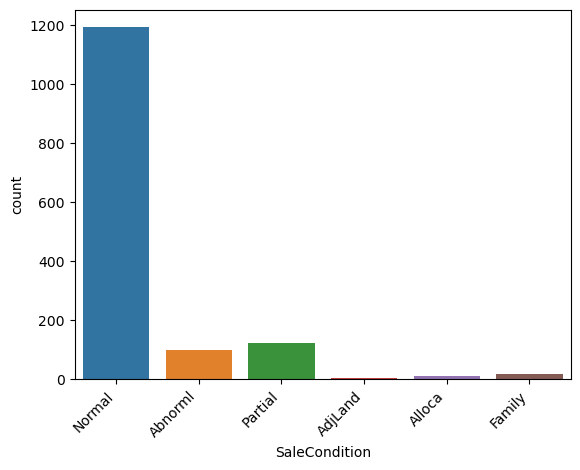

In [39]:
visualize_categorical_distribution(housing_df)

## Step 2: Visualising the Data

#### Visualising Numeric Variables

Visualize pairplot of numeric variables

In [40]:
# Select features of data type integer or float
numeric_features = housing_df.select_dtypes(include=['int', 'float']).columns
print(numeric_features)

Index(['LotFrontage', 'LotArea', 'YearBuilt', 'YearRemodAdd', 'MasVnrArea',
       'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF',
       '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath',
       'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd',
       'Fireplaces', 'GarageYrBlt', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea',
       'MiscVal', 'MoSold', 'YrSold', 'SalePrice'],
      dtype='object')


In [41]:
def create_scatterplot(data, x_vars, y_var, plots_per_row=2, plot_height=5):
    num_vars = len(x_vars)
    num_rows = math.ceil(num_vars / plots_per_row)
    fig, axes = plt.subplots(num_rows, plots_per_row, figsize=(plots_per_row * 5, num_rows * plot_height))
    for i, ax_row in enumerate(axes):
        for j, ax in enumerate(ax_row):
            idx = i * plots_per_row + j
            if idx < num_vars:
                sns.scatterplot(x=x_vars[idx], y=y_var, data=data, ax=ax)
    plt.tight_layout()
    plt.show()

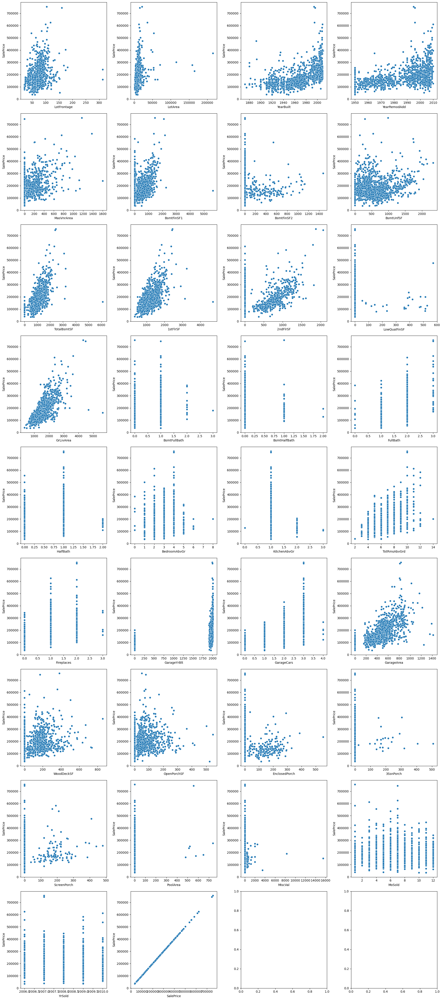

In [42]:
# Plotting numerical features against target variable SalePrice
create_scatterplot(housing_df, numeric_features, 'SalePrice', plots_per_row=4, plot_height=5)

#### Visualising Categorical Variables

Boxplot for visualising Categorical Variables

In [43]:
# Select categorical features
cat_features = housing_df.select_dtypes(include=['object']).columns
print(cat_features)

Index(['MSSubClass', 'MSZoning', 'Street', 'Alley', 'LotShape', 'LandContour',
       'Utilities', 'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1',
       'Condition2', 'BldgType', 'HouseStyle', 'OverallQual', 'OverallCond',
       'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType',
       'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond',
       'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Heating', 'HeatingQC',
       'CentralAir', 'Electrical', 'KitchenQual', 'Functional', 'FireplaceQu',
       'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond', 'PavedDrive',
       'PoolQC', 'Fence', 'MiscFeature', 'SaleType', 'SaleCondition'],
      dtype='object')


In [44]:
# Function to plot the boxplot with percentage for categorical variables

def plot_boxplot(data, category_col, target_col):
     # total count for each category using groupby
    total_counts = data.groupby(category_col)[target_col].sum()

    # percentage of each category against the total count
    percentage_counts = total_counts / total_counts.sum() * 100

    # Create a box plot
    plt.figure(figsize=(10, 5))
    ax = sns.boxplot(x=category_col, y=target_col, data=data)
    
    # Rotate x-axis labels
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

    plt.show()

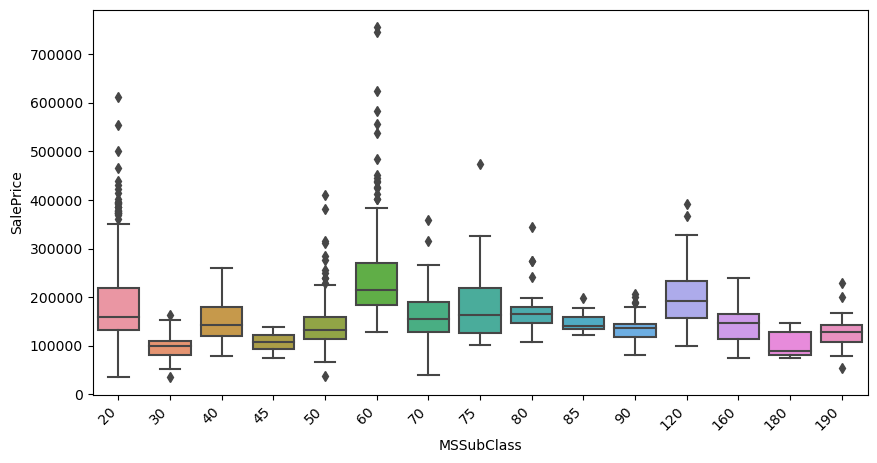

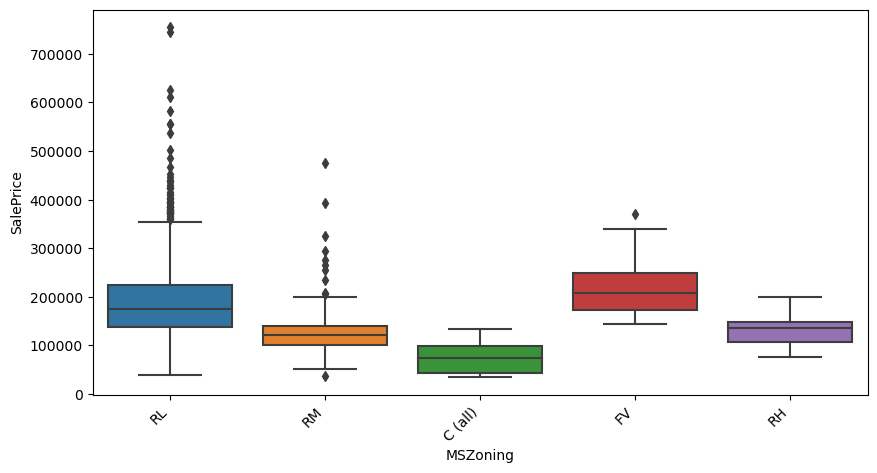

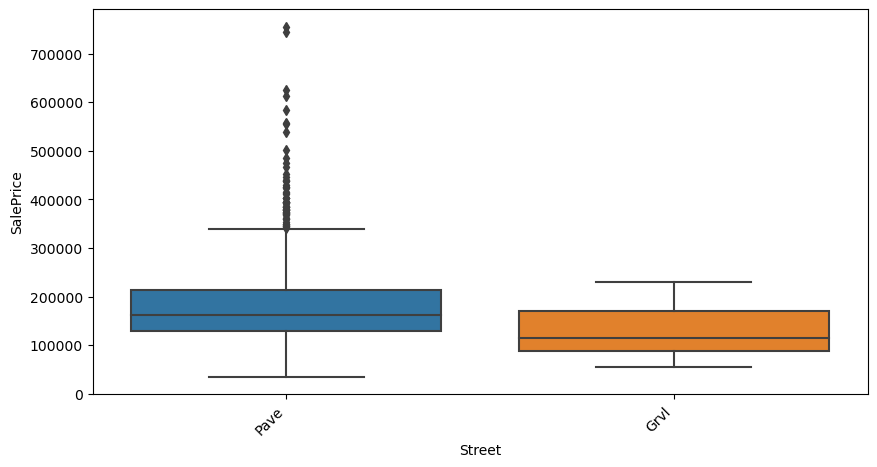

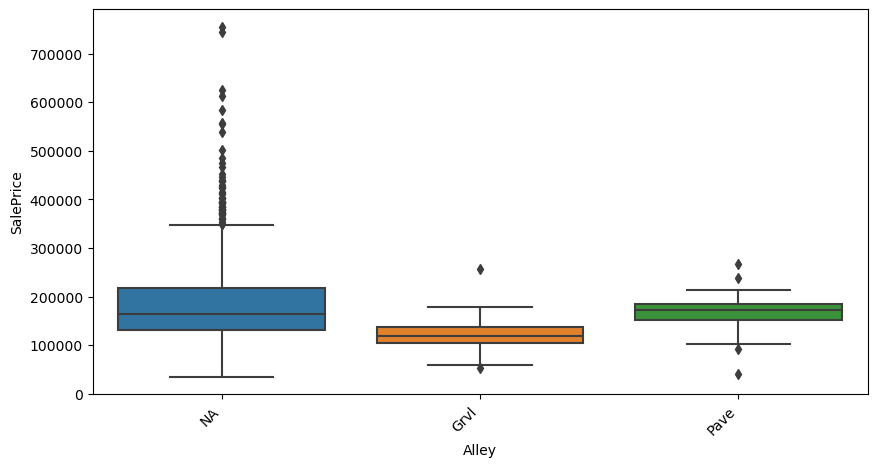

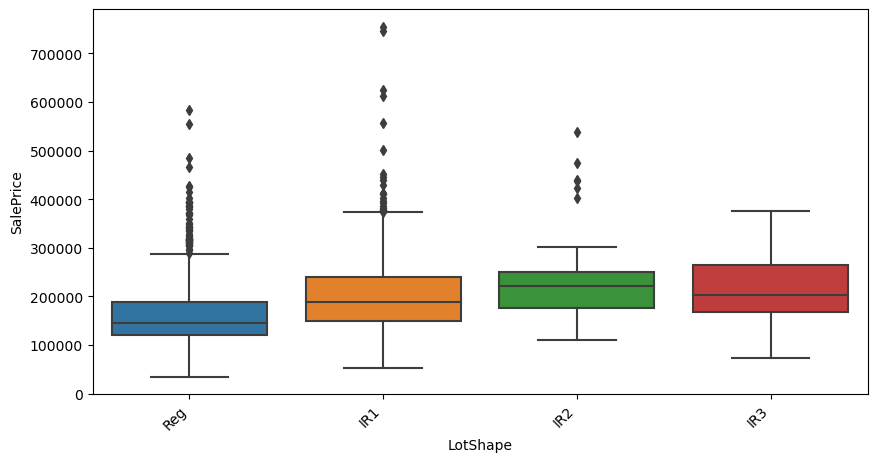

...

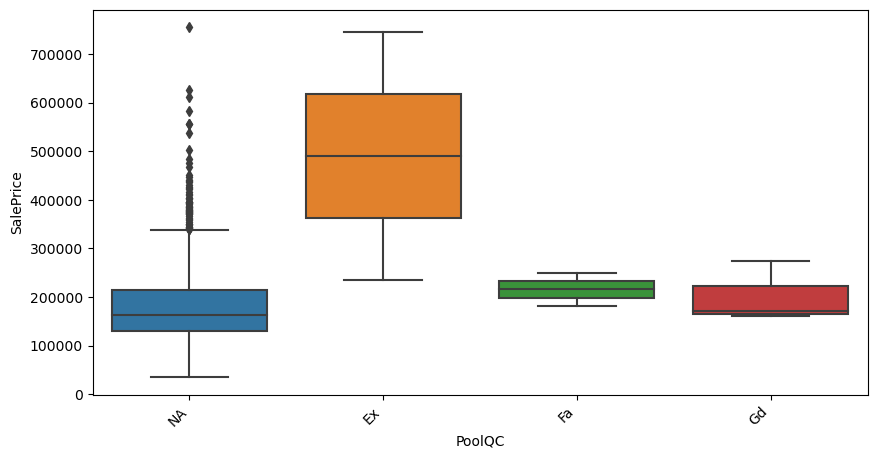

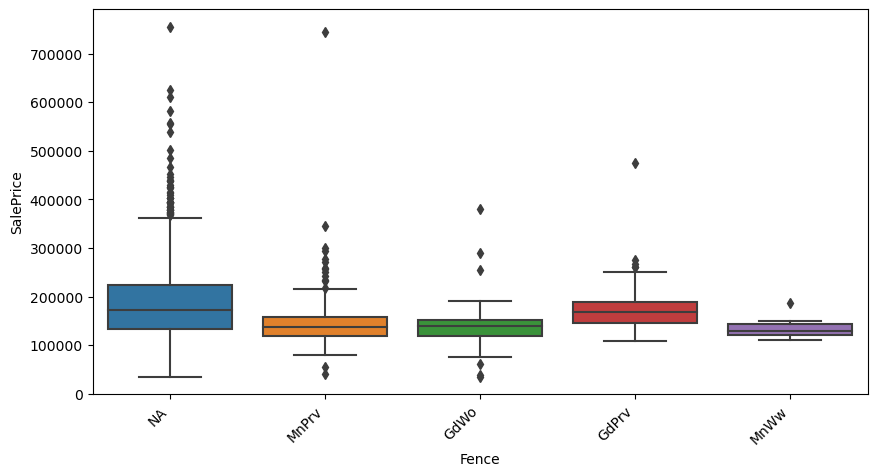

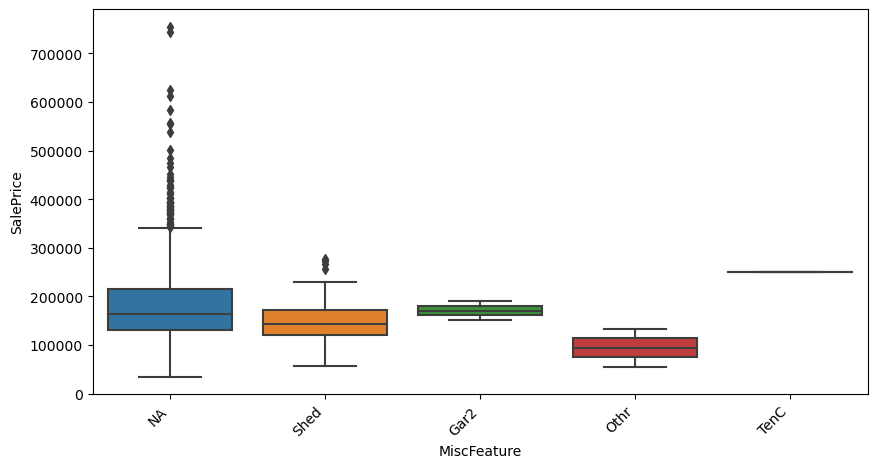

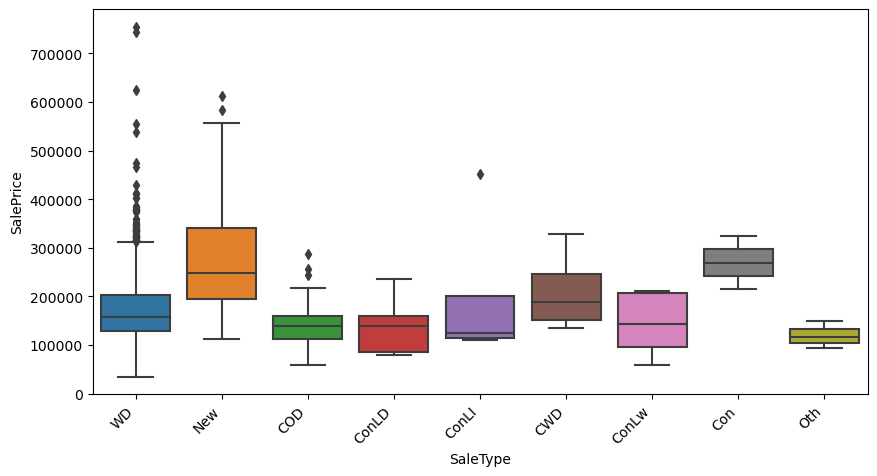

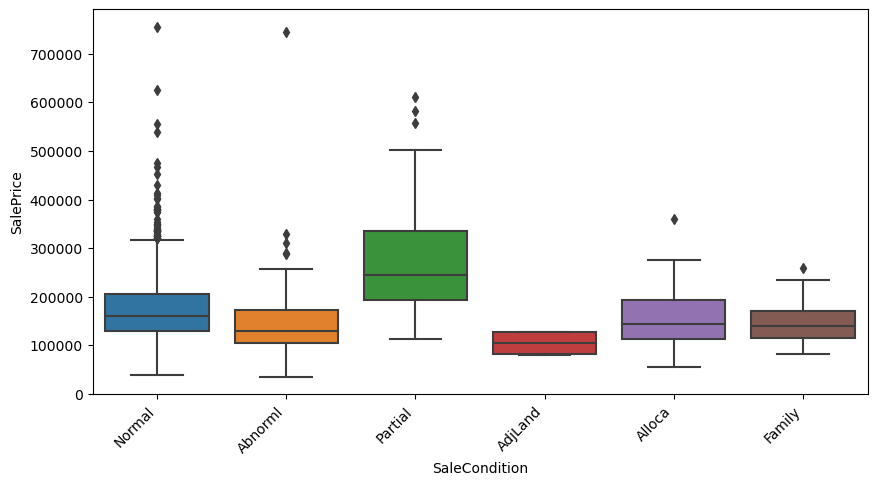

In [45]:
# Poltting box plot for categorical features
for col in cat_features:
    plot_boxplot(housing_df,col,'SalePrice')

<Axes: xlabel='SalePrice', ylabel='Density'>

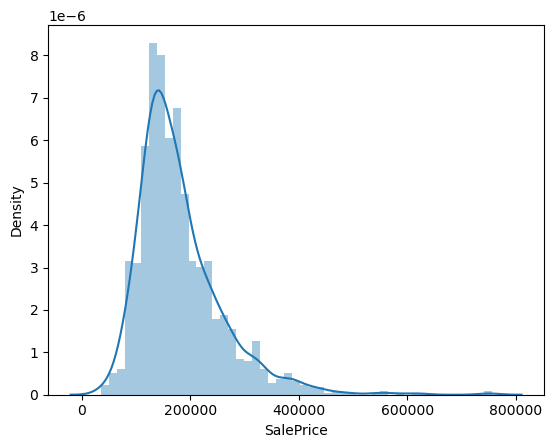

In [46]:
# Checking distribution of SalePrice
sns.distplot(housing_df['SalePrice'])

#Inference: SalePrice feature is right skewed

## Step 3: Data Preparation

#### Dummy variables

In [47]:
# Creating dummy varaibles for categorical varaibles 

In [48]:
# Function to fetch the columns with more than 2 sub-categories and with 2 sub-categories
def categorize_categorical_columns(df):
    # Get list of categorical columns
    categorical_columns = df.select_dtypes(include=['object']).columns

    # Initialize lists to store column names
    more_than_2_subcategories = []
    exactly_2_subcategories = []

    # Iterate over categorical columns
    for col in categorical_columns:
        unique_categories = df[col].nunique()
        if unique_categories > 2:
            more_than_2_subcategories.append(col)
        elif unique_categories == 2:
            exactly_2_subcategories.append(col)

    return more_than_2_subcategories, exactly_2_subcategories

In [49]:
more_than_2_sub, exactly_2_sub = categorize_categorical_columns(housing_df)
print("more than 2 sub categories: ", more_than_2_sub)
print("exactly 2 sub categories: ", exactly_2_sub)

more than 2 sub categories:  ['MSSubClass', 'MSZoning', 'Alley', 'LotShape', 'LandContour', 'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'OverallQual', 'OverallCond', 'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Heating', 'HeatingQC', 'Electrical', 'KitchenQual', 'Functional', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond', 'PavedDrive', 'PoolQC', 'Fence', 'MiscFeature', 'SaleType', 'SaleCondition']
exactly 2 sub categories:  ['Street', 'Utilities', 'CentralAir']


In [50]:
# 'Street','Utilities', 'CentralAir' have 2 unique data, and hence encoding with 0 and 1

In [51]:
# Encoding 'Street' feature
print(housing_df['Street'].value_counts())
housing_df['Street']= housing_df['Street'].map(lambda x: 1 if x== 'Pave' else 0)

print(housing_df['Street'].value_counts())

Pave    1445
Grvl       6
Name: Street, dtype: int64
1    1445
0       6
Name: Street, dtype: int64


In [52]:
# Encoding 'Utilities' feature
print(housing_df['Utilities'].value_counts())
housing_df['Utilities']= housing_df['Utilities'].map(lambda x: 1 if x== 'AllPub' else 0)

print(housing_df['Utilities'].value_counts())

AllPub    1450
NoSeWa       1
Name: Utilities, dtype: int64
1    1450
0       1
Name: Utilities, dtype: int64


In [53]:
# Encoding 'CentralAir' feature
print(housing_df['CentralAir'].value_counts())
housing_df['CentralAir']= housing_df['CentralAir'].map(lambda x: 1 if x== 'Y' else 0)

print(housing_df['CentralAir'].value_counts())

Y    1356
N      95
Name: CentralAir, dtype: int64
1    1356
0      95
Name: CentralAir, dtype: int64


In [54]:
# Creating dummy varaibles for categorical varaibles having more than 2 categories in it

In [55]:
def create_dummies(data, column_name):
    # Let's drop the first column from status df using 'drop_first = True'
    status = pd.get_dummies(data[column_name],prefix=column_name, drop_first = True)
    # Add the results to the original housing dataframe
    data = pd.concat([data, status], axis = 1)
    # Drop column as we have created the dummies for it
    data.drop([column_name], axis = 1, inplace = True)
    return data

In [56]:
# Creating dummies for the following categorical columns using create_dummies() function

In [57]:
for col in more_than_2_sub:
    housing_df =create_dummies(housing_df,col)

In [58]:
housing_df.shape

# Insights: We can see that columns have increased after dummy varaible creation

(1451, 288)

In [59]:
# Viewing the columns after dummy creation
for col in housing_df.columns:
    print(col)

LotFrontage
LotArea
Street
Utilities
YearBuilt
YearRemodAdd
MasVnrArea
BsmtFinSF1
BsmtFinSF2
BsmtUnfSF
TotalBsmtSF
CentralAir
1stFlrSF
2ndFlrSF
LowQualFinSF
GrLivArea
BsmtFullBath
BsmtHalfBath
FullBath
HalfBath
BedroomAbvGr
KitchenAbvGr
TotRmsAbvGrd
Fireplaces
GarageYrBlt
GarageCars
GarageArea
WoodDeckSF
OpenPorchSF
EnclosedPorch
3SsnPorch
ScreenPorch
PoolArea
MiscVal
MoSold
YrSold
SalePrice
MSSubClass_30
MSSubClass_40
MSSubClass_45
MSSubClass_50
MSSubClass_60
MSSubClass_70
MSSubClass_75
MSSubClass_80
MSSubClass_85
MSSubClass_90
MSSubClass_120
MSSubClass_160
MSSubClass_180
MSSubClass_190
MSZoning_FV
MSZoning_RH
MSZoning_RL
MSZoning_RM
Alley_NA
Alley_Pave
LotShape_IR2
LotShape_IR3
LotShape_Reg
LandContour_HLS
LandContour_Low
LandContour_Lvl
LotConfig_CulDSac
LotConfig_FR2
LotConfig_FR3
LotConfig_Inside
LandSlope_Mod
LandSlope_Sev
Neighborhood_Blueste
Neighborhood_BrDale
Neighborhood_BrkSide
Neighborhood_ClearCr
Neighborhood_CollgCr
Neighborhood_Crawfor
Neighborhood_Edwards
Neighborhood_

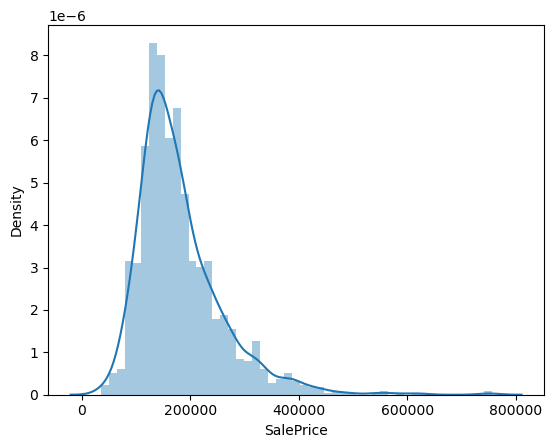

In [60]:
# Distplot of  SalePrice
sns.distplot(housing_df['SalePrice'])
plt.show()

In [61]:
# Transforming 'SalePrice' using log transformation to correct the skewness
housing_df['SalePrice']= np.log(housing_df['SalePrice'])

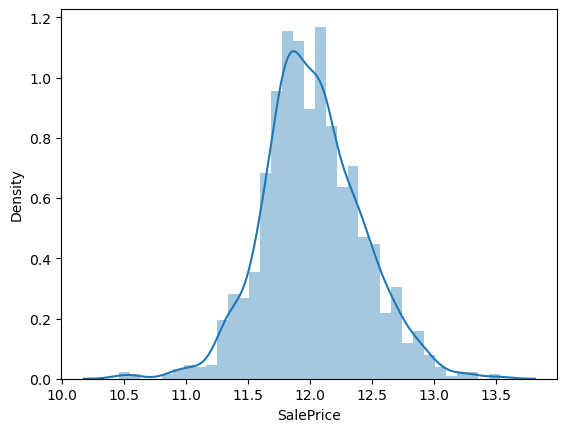

In [62]:
# Distplot of log transformed SalePrice
sns.distplot(housing_df['SalePrice'])
plt.show()

#Inference: After log transformation the SlaePrice feature's distribution looks normal 

## Step 4: Splitting the Data into Training and Testing Sets

In [63]:
y = housing_df.pop('SalePrice')
X = housing_df

In [64]:
X.head()

,LotFrontage,LotArea,Street,Utilities,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,CentralAir,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,MSSubClass_30,MSSubClass_40,MSSubClass_45,MSSubClass_50,MSSubClass_60,MSSubClass_70,MSSubClass_75,MSSubClass_80,MSSubClass_85,MSSubClass_90,MSSubClass_120,MSSubClass_160,MSSubClass_180,MSSubClass_190,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Alley_NA,Alley_Pave,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,OverallQual_2,OverallQual_3,OverallQual_4,OverallQual_5,OverallQual_6,OverallQual_7,OverallQual_8,OverallQual_9,OverallQual_10,OverallCond_2,OverallCond_3,OverallCond_4,OverallCond_5,OverallCond_6,OverallCond_7,OverallCond_8,OverallCond_9,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_NA,BsmtQual_TA,BsmtCond_Gd,BsmtCond_NA,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_NA,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_NA,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_NA,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Sev,Functional_Typ,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_NA,FireplaceQu_Po,FireplaceQu_TA,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_NA,GarageFinish_NA,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Fa,GarageQual_Gd,GarageQual_NA,GarageQual_Po,GarageQual_TA,GarageCond_Fa,GarageCond_Gd,

In [65]:
y.head()

0    12.247694
1    12.109011
2    12.317167
3    11.849398
4    12.429216
Name: SalePrice, dtype: float64

In [66]:
from sklearn.model_selection import train_test_split

# We specify this so that the train and test data set always have the same rows, respectively
np.random.seed(0)
X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                    train_size=0.7,
                                                    test_size = 0.3, random_state=100)

In [67]:
# Shape of train data
X_train.shape

(1015, 287)

In [68]:
# Shape of test data
X_test.shape

(436, 287)

### Rescaling the Features 

Using Standard Scaler for rescaling the features

In [69]:
from sklearn.preprocessing import StandardScaler

In [70]:
scaler = StandardScaler()

In [71]:
# Apply scaler() to all the numerical columns 

In [72]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1015 entries, 801 to 795
Columns: 287 entries, LotFrontage to SaleCondition_Partial
dtypes: float64(3), int64(33), uint8(251)
memory usage: 542.2 KB


In [73]:
# Lets scale only numeric varaibles(int64, float64), scaling of uint8 variables are  ot required as it were created during dummy creation and its value is 0 or 1
numeric_var = list(X_train.select_dtypes(include=['int64', 'float64']).columns)

In [74]:
numeric_var

['LotFrontage',
 'LotArea',
 'Street',
 'Utilities',
 'YearBuilt',
 'YearRemodAdd',
 'MasVnrArea',
 'BsmtFinSF1',
 'BsmtFinSF2',
 'BsmtUnfSF',
 'TotalBsmtSF',
 'CentralAir',
 '1stFlrSF',
 '2ndFlrSF',
 'LowQualFinSF',
 'GrLivArea',
 'BsmtFullBath',
 'BsmtHalfBath',
 'FullBath',
 'HalfBath',
 'BedroomAbvGr',
 'KitchenAbvGr',
 'TotRmsAbvGrd',
 'Fireplaces',
 'GarageYrBlt',
 'GarageCars',
 'GarageArea',
 'WoodDeckSF',
 'OpenPorchSF',
 'EnclosedPorch',
 '3SsnPorch',
 'ScreenPorch',
 'PoolArea',
 'MiscVal',
 'MoSold',
 'YrSold']

In [75]:
# Apply scaler() to all the numerical columns 

X_train[numeric_var] = scaler.fit_transform(X_train[numeric_var])

#Note: fit_transform is used only for train data not for test data

In [76]:
X_train[numeric_var].head()

#After scaling it is observed that data is between 0 ad 1

,LotFrontage,LotArea,Street,Utilities,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,CentralAir,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold
801,-1.298599,-0.513865,0.077113,0.031404,-1.872354,0.238209,-0.562965,-0.502945,-0.297804,0.936307,0.294756,0.259418,0.093340,-0.806741,-0.119133,-0.596512,1.117470,-0.237207,-1.036398,-0.783948,-1.066139,-0.203425,-0.912168,-0.953172,0.185746,0.300833,-0.162574,-0.736684,-0.689360,-0.355443,-0.130363,-0.272788,-0.069432,-0.165066,0.294747,-0.624342
569,-0.041883,-0.315476,0.077113,0.031404,0.236493,-0.301373,-0.562965,1.097605,-0.297804,-1.320626,-0.273317,0.259418,-0.544243,-0.806741,-0.119133,-1.065805,1.117470,-0.237207,-1.036398,-0.783948,-1.066139,-0.203425,-1.519284,2.172740,0.235656,0.300833,0.591510,-0.392118,-0.689360,-0.355443,-0.130363,-0.272788,-0.069432,-0.165066,2.159886,-1.371639
1181,-0.258558,-0.443913,0.077113,0.031404,1.207232,1.121161,0.447197,2.249743,-0.297804,-1.049523,1.201876,0.259418,1.242503,-0.806741,-0.119133,0.249328,1.117470,4.062174,0.793070,-0.783948,-1.066139,-0.203425,-0.912168,0.609784,0.301447,0.300833,0.035373,0.592359,0.074914,-0.355443,4.353511,-0.272788,-0.069432,-0.165066,1.786858,0.122954
808,0.651477,0.250537,0.077113,0.031404,-0.198666,-0.939061,5.123271,0.181472,0.484095,-0.462133,-0.091444,0.259418,-0.183870,-0.806741,-0.119133,-0.800552,1.117470,-0.237207,-1.036398,-0.783948,0.176262,-0.203425,-0.305053,0.609784,0.206163,0.300833,0.044799,-0.736684,-0.689360,-0.355443,-0.130363,-0.272788,-0.069432,-0.165066,-0.078281,-1.371639
1095,0.348132,-0.112376,0.077113,0.031404,1.140284,1.023055,-0.562965,-0.874119,-0.297804,1.593732,0.559707,0.259418,0.390711,-0.806741,-0.119133,-0.377633,-0.792011,-0.237207,0.793070,-0.783948,0.176262,-0.203425,-0.305053,0.609784,0.296910,0.300833,-0.162574,-0.736684,-0.372114,-0.355443,-0.130363,-0.272788,-0.069432,-0.165066,-1.197364,-0.624342


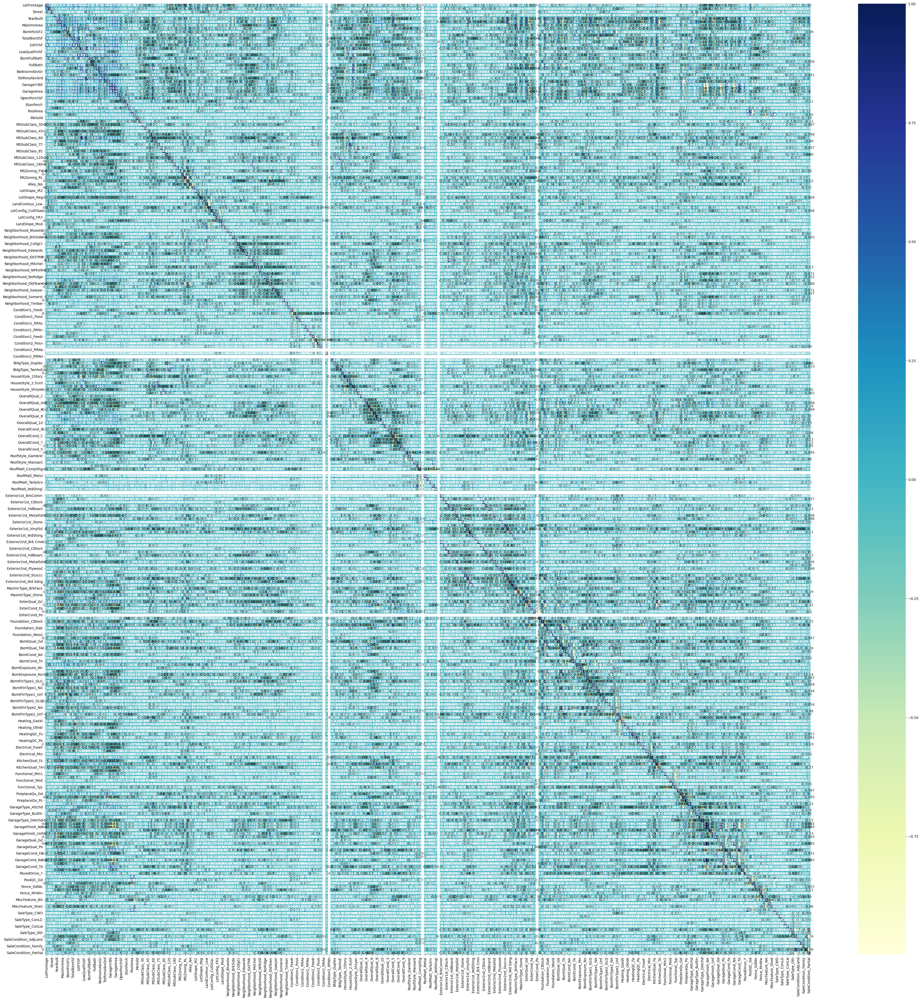

In [77]:
# Let's check the correlation coefficients to see which variables are highly correlated

plt.figure(figsize = (50, 50))
sns.heatmap(X_train.corr(), annot = True, cmap="YlGnBu")
plt.show()

#Inference: It is difficult to infer using the heatmap for more number of features. 
# After RFE, We shall use correlation numbers to determine the collinearity between the features

In [78]:
# Remove the columns having low variance

In [79]:
from sklearn.feature_selection import VarianceThreshold

In [80]:
# Initialize VarianceThreshold
var_t = VarianceThreshold(threshold=0.003)

var_t.fit(X_train)

# Get the boolean mask indicating selected features
selected_features_mask = var_t.get_support()

# Get the column names of the selected features
selected_feature_names = X_train.columns[selected_features_mask]


In [81]:
# Print the selected feature names
print(selected_feature_names)

Index(['LotFrontage', 'LotArea', 'Street', 'Utilities', 'YearBuilt',
       'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF',
       ...
       'MiscFeature_Shed', 'SaleType_CWD', 'SaleType_ConLD', 'SaleType_New',
       'SaleType_WD', 'SaleCondition_AdjLand', 'SaleCondition_Alloca',
       'SaleCondition_Family', 'SaleCondition_Normal',
       'SaleCondition_Partial'],
      dtype='object', length=243)


In [82]:
X_train_variance = X_train[selected_feature_names]

In [83]:
X_train.shape

(1015, 287)

In [84]:
X_train_variance.shape

(1015, 243)

In [85]:
X_train_variance.head()

,LotFrontage,LotArea,Street,Utilities,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,CentralAir,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,MSSubClass_30,MSSubClass_45,MSSubClass_50,MSSubClass_60,MSSubClass_70,MSSubClass_75,MSSubClass_80,MSSubClass_85,MSSubClass_90,MSSubClass_120,MSSubClass_160,MSSubClass_180,MSSubClass_190,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Alley_NA,Alley_Pave,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_Inside,LandSlope_Mod,LandSlope_Sev,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition2_Norm,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,OverallQual_3,OverallQual_4,OverallQual_5,OverallQual_6,OverallQual_7,OverallQual_8,OverallQual_9,OverallQual_10,OverallCond_3,OverallCond_4,OverallCond_5,OverallCond_6,OverallCond_7,OverallCond_8,OverallCond_9,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofMatl_CompShg,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_BrkFace,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_NA,BsmtQual_TA,BsmtCond_Gd,BsmtCond_NA,BsmtCond_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_NA,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_NA,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_NA,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_TA,Electrical_FuseF,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Typ,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_NA,FireplaceQu_Po,FireplaceQu_TA,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_NA,GarageFinish_NA,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Fa,GarageQual_Gd,GarageQual_NA,GarageQual_TA,GarageCond_Fa,GarageCond_Gd,GarageCond_NA,GarageCond_Po,GarageCond_TA,PavedDrive_P,PavedDrive_Y,PoolQC_NA,Fence_GdWo,Fence_MnPrv,Fence_MnWw,Fence_NA,MiscFeature_NA,MiscFeature_Shed,SaleType_CWD,SaleType_ConLD,SaleType_New,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
801,-1.298599,-0.513865,0.077113,0.031404,-1.872354,0.238209,-0.562965,-0.502945,-0.297804,0.936307,0.294756,0.259418,0.093340,-0.806741,-0.119133,-0.596512,1.117470,-0.237207,-1.036398,-0.783948,-1.066139,-0.203425,-0.912168,-0.953172,0.185746,0.300833,-0.162574,-0

In [86]:
# Lets look at Correlations between features and remove the hihly correlated one

In [87]:
# Calculate the correlation matrix
corr_matrix = X_train_variance.corr().abs()

# Create a mask to identify highly correlated features
mask = corr_matrix.mask(np.tril(np.ones(corr_matrix.shape)).astype(np.bool))

# Find indices of feature pairs with correlation above a threshold (e.g., 0.7)
highly_correlated_pairs = np.where(mask > 0.7)

# Get unique features from the correlated pairs
unique_features = np.unique(highly_correlated_pairs[0])


In [88]:
# Store removed features and their correlations with other features
removed_features = {}
for feature in X_train_variance.columns[unique_features]:
    correlated_features = corr_matrix.loc[feature][corr_matrix.loc[feature] > 0.7].index.tolist()
    removed_features[feature] = correlated_features

In [89]:
# Remove one of the highly correlated features from the dataset
X_train_filtered = X_train_variance.drop(X_train_variance.columns[unique_features], axis=1)

In [90]:
X_train_filtered.shape

(1015, 193)

In [91]:
# Print removed features and their correlations
for feature, correlated_features in removed_features.items():
    print(f"Feature '{feature}' was removed due to multicollinearity.")
    for correlated_feature in correlated_features:
        print(f"- Correlation with '{correlated_feature}': {corr_matrix.loc[feature, correlated_feature]}")

Feature 'BsmtFinSF2' was removed due to multicollinearity.
- Correlation with 'BsmtFinSF2': 1.0
- Correlation with 'BsmtFinType2_Unf': 0.7445106760293707
Feature 'TotalBsmtSF' was removed due to multicollinearity.
- Correlation with 'TotalBsmtSF': 1.0
- Correlation with '1stFlrSF': 0.8374765647915065
Feature '2ndFlrSF' was removed due to multicollinearity.
- Correlation with '2ndFlrSF': 1.0
- Correlation with 'HouseStyle_1Story': 0.792475505389341
- Correlation with 'HouseStyle_2Story': 0.8046310116435355
Feature 'GrLivArea' was removed due to multicollinearity.
- Correlation with 'GrLivArea': 1.0
- Correlation with 'TotRmsAbvGrd': 0.8265468636681621
Feature 'Fireplaces' was removed due to multicollinearity.
- Correlation with 'Fireplaces': 1.0
- Correlation with 'FireplaceQu_NA': 0.9010662087841805
Feature 'GarageYrBlt' was removed due to multicollinearity.
- Correlation with 'GarageYrBlt': 1.0
- Correlation with 'GarageType_NA': 0.9985009601284346
- Correlation with 'GarageFinish_NA'

### Building the model

Model shall be built using Ridge and Lasso function from SciKit Learn for its compatibility with RFE (which is a utility from sklearn)

Feature selection is done using automated way RFE (Recursive feature elimination)

### Ridge Regression

In [92]:
# Find the optimal number of features for RFE using GridsearchCV

In [93]:
# number of features in X_train filtered one
len(X_train_filtered.columns)

193

In [94]:

# specify range of hyperparameters to tune
param_grid = {
    'n_features_to_select': np.arange(1, X.shape[1] + 1)
}

# Create RFE with Ridge estimator
ridge = Ridge()
rfe = RFE(estimator=ridge)

# Perform grid search with cross-validation to find optimal features using RFE
grid_search_rfe = GridSearchCV(rfe, param_grid, cv=5, verbose = 1, n_jobs=-1, return_train_score=True)

grid_search_rfe.fit(X_train_filtered, y_train)

Fitting 5 folds for each of 287 candidates, totalling 1435 fits


GridSearchCV(cv=5, estimator=RFE(estimator=Ridge()), n_jobs=-1,
             param_grid={'n_features_to_select': array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
        14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
        27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
        40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
        53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
        66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
        79,  80,  81,  82,  83,  84,  85,  8...
       209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221,
       222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234,
       235, 236, 237, 238, 239, 240, 241, 242, 243, 244, 245, 246, 247,
       248, 249, 250, 251, 252, 253, 254, 255, 256, 257, 258, 259, 260,
       261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273,
       274, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286,
       287])},
             return_train_score=True, verbose=1)

In [95]:
# Get the best RFE estimator with optimal number of features
best_rfe = grid_search_rfe.best_estimator_
optimal_num_features = grid_search_rfe.best_params_['n_features_to_select']

In [96]:
optimal_num_features

145

In [97]:
# Get selected features using RFE
selected_features_rfe = [feature for feature, support in zip(X_train_filtered.columns, best_rfe.support_) if support]

In [98]:
selected_features_rfe

['LotArea',
 'YearBuilt',
 'YearRemodAdd',
 'BsmtFinSF1',
 'CentralAir',
 '1stFlrSF',
 'BsmtFullBath',
 'FullBath',
 'HalfBath',
 'BedroomAbvGr',
 'KitchenAbvGr',
 'TotRmsAbvGrd',
 'GarageArea',
 'WoodDeckSF',
 'EnclosedPorch',
 'ScreenPorch',
 'MSSubClass_30',
 'MSSubClass_50',
 'MSSubClass_70',
 'MSSubClass_160',
 'MSSubClass_180',
 'MSZoning_RH',
 'MSZoning_RM',
 'Alley_Pave',
 'LotShape_IR2',
 'LotShape_IR3',
 'LandContour_HLS',
 'LandContour_Low',
 'LandContour_Lvl',
 'LotConfig_CulDSac',
 'LotConfig_FR2',
 'LotConfig_Inside',
 'LandSlope_Sev',
 'Neighborhood_BrDale',
 'Neighborhood_BrkSide',
 'Neighborhood_ClearCr',
 'Neighborhood_CollgCr',
 'Neighborhood_Crawfor',
 'Neighborhood_Edwards',
 'Neighborhood_IDOTRR',
 'Neighborhood_MeadowV',
 'Neighborhood_Mitchel',
 'Neighborhood_NPkVill',
 'Neighborhood_NoRidge',
 'Neighborhood_NridgHt',
 'Neighborhood_OldTown',
 'Neighborhood_Somerst',
 'Neighborhood_StoneBr',
 'Neighborhood_Timber',
 'Neighborhood_Veenker',
 'Condition1_Feedr',
 

In [99]:
# Remove features with low variance

#selector_variance = VarianceThreshold()
#X_train_variance = selector_variance.fit_transform(X_train)

# Assuming selected_features_rfe contains feature indices selected by RFE
#selected_features_rfe_indices = [index for index, feature in enumerate(selected_features_rfe) if feature in X_train.columns]

# Select corresponding features from the original dataset
#selected_features_variance = X_train.columns[selected_features_rfe_indices]

In [100]:
#X_train_selected= X_train[selected_features_variance]

In [101]:
X_train_selected= X_train_filtered[selected_features_rfe]

In [102]:
X_train_selected.head()

,LotArea,YearBuilt,YearRemodAdd,BsmtFinSF1,CentralAir,1stFlrSF,BsmtFullBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,GarageArea,WoodDeckSF,EnclosedPorch,ScreenPorch,MSSubClass_30,MSSubClass_50,MSSubClass_70,MSSubClass_160,MSSubClass_180,MSZoning_RH,MSZoning_RM,Alley_Pave,LotShape_IR2,LotShape_IR3,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_Inside,LandSlope_Sev,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NPkVill,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_RRAe,Condition1_RRAn,Condition2_Norm,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,OverallQual_3,OverallQual_4,OverallQual_5,OverallQual_6,OverallQual_7,OverallQual_8,OverallQual_9,OverallQual_10,OverallCond_3,OverallCond_4,OverallCond_6,OverallCond_7,OverallCond_8,OverallCond_9,RoofStyle_Hip,RoofStyle_Mansard,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_BrkFace,Exterior1st_WdShing,Exterior2nd_Brk Cmn,Exterior2nd_CmentBd,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_Stone,ExterQual_TA,ExterCond_Fa,Foundation_PConc,BsmtQual_Fa,BsmtQual_TA,BsmtCond_Gd,BsmtCond_TA,BsmtExposure_Gd,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_NA,BsmtFinType2_Rec,Heating_GasW,Heating_Grav,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_TA,Electrical_FuseF,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_TA,Functional_Maj2,Functional_Typ,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_NA,FireplaceQu_Po,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageQual_Fa,GarageQual_Gd,GarageCond_Fa,GarageCond_Po,GarageCond_TA,PavedDrive_P,PavedDrive_Y,PoolQC_NA,Fence_GdWo,MiscFeature_Shed,SaleType_CWD,SaleType_ConLD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
801,-0.513865,-1.872354,0.238209,-0.502945,0.259418,0.093340,1.117470,-1.036398,-0.783948,-1.066139,-0.203425,-0.912168,-0.162574,-0.736684,-0.355443,-0.272788,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,1,0
569,-0.315476,0.236493,-0.301373,1.097605,0.259418,-0.544243,1.117470,-1.036398,-0.783948,-1.066139,-0.203425,-1.519284,0.591510,-0.392118,-0.355443,-0.272788,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,1,0
1181,-0.443913,1.207232,1.121161,2.249743,0.259418,1.242503,1.117470,0.793070,-0.783948,-1.066139,-0.203425,-0.912168,0.035373,0.592359,-0.355443,-0.272788,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,1
808,0.250537,-0.198666,-0.939061,0.181472,0.259418,-0.183870,1.117470,-1.036398,-0.783948,0.176262,-0.203425,-0.305053,0.044799,-0.736684,-0.355443,-0.272788,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,1,1,1,0,0,0,0,0,0,1,0
1095,-0.112376,1.140284,1.023055,-0

In [103]:
X_train_selected.shape

(1015, 145)

In [104]:
# Modelling

In [105]:
# list of alphas to tune - if value too high it will lead to underfitting, if it is too low, 
# it will not handle the overfitting
params = {'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 
 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0, 
 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50, 100, 500, 1000 ]}

ridge = Ridge()

# cross validation
folds = 5
model_cv = GridSearchCV(estimator = ridge, 
                        param_grid = params, 
                        scoring= 'neg_mean_absolute_error',  
                        cv = folds, 
                        return_train_score=True,
                        verbose = 1)            
model_cv.fit(X_train_selected, y_train)

Fitting 5 folds for each of 28 candidates, totalling 140 fits


GridSearchCV(cv=5, estimator=Ridge(),
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3,
                                   0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0,
                                   4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50,
                                   100, 500, 1000]},
             return_train_score=True, scoring='neg_mean_absolute_error',
             verbose=1)

In [106]:
# Printing the best hyperparameter alpha
print(model_cv.best_params_)

{'alpha': 6.0}


In [107]:
#Fitting Ridge model for alpha = 6 and printing coefficients which have been penalised
alpha = 6
ridge = Ridge(alpha=alpha)

ridge.fit(X_train_selected, y_train)
print(ridge.coef_)

[ 0.0159215   0.01095003  0.01939939 -0.00745058  0.0259831   0.06405713
  0.02598766  0.0391267   0.03567201  0.01096351 -0.01937419  0.04729966
  0.04190949  0.01730519  0.01282671  0.0202734  -0.08823812  0.02233304
  0.0394244  -0.06367703 -0.02964608  0.04336802 -0.00467873  0.07343002
  0.03071834 -0.06604392  0.07579296  0.04864568  0.04763219  0.03497311
 -0.02012332 -0.02085213 -0.00189477 -0.02435261  0.03728512  0.04778974
  0.00779408  0.1174383  -0.05256267 -0.12436594 -0.10463433 -0.01540581
  0.00811305  0.09612082  0.11647677 -0.03535688  0.05805502  0.10889438
  0.00179076  0.04121382 -0.02330832  0.05022623 -0.01500714 -0.03087631
  0.01223597  0.08208494  0.01218559 -0.061266   -0.03319399  0.01021348
  0.07007272  0.07087428  0.03273829 -0.02130229 -0.13898287 -0.07156783
 -0.03902462 -0.01420523  0.0212448   0.08973436  0.19652988  0.08991077
 -0.12729774 -0.07095214  0.02112046  0.06778749  0.04589785  0.10319255
  0.02780363  0.0163142   0.00842623  0.05815198  0

In [108]:
# Lets scale the X test and include the features same as in X train selected

In [109]:
# Apply scaler() to all the numerical columns 

X_test[numeric_var] = scaler.transform(X_test[numeric_var])


In [110]:
X_test.head()

,LotFrontage,LotArea,Street,Utilities,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,CentralAir,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,MSSubClass_30,MSSubClass_40,MSSubClass_45,MSSubClass_50,MSSubClass_60,MSSubClass_70,MSSubClass_75,MSSubClass_80,MSSubClass_85,MSSubClass_90,MSSubClass_120,MSSubClass_160,MSSubClass_180,MSSubClass_190,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Alley_NA,Alley_Pave,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,OverallQual_2,OverallQual_3,OverallQual_4,OverallQual_5,OverallQual_6,OverallQual_7,OverallQual_8,OverallQual_9,OverallQual_10,OverallCond_2,OverallCond_3,OverallCond_4,OverallCond_5,OverallCond_6,OverallCond_7,OverallCond_8,OverallCond_9,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_NA,BsmtQual_TA,BsmtCond_Gd,BsmtCond_NA,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_NA,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_NA,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_NA,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Sev,Functional_Typ,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_NA,FireplaceQu_Po,FireplaceQu_TA,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_NA,GarageFinish_NA,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Fa,GarageQual_Gd,GarageQual_NA,GarageQual_Po,GarageQual_TA,GarageCond_Fa,GarageCond_Gd,

In [111]:
# Let create the test data with only the selected features in X train

In [112]:
X_test_selected = X_test[X_train_selected.columns]

In [113]:
X_test_selected.shape

(436, 145)

In [114]:
# Lets calculate some metrics such as R2 score, RSS and RMSE
y_pred_train = ridge.predict(X_train_selected)
y_pred_test = ridge.predict(X_test_selected)

metric1 = []
r2_train_lr = r2_score(y_train, y_pred_train)
print(r2_train_lr)
metric1.append(r2_train_lr)

r2_test_lr = r2_score(y_test, y_pred_test)
print(r2_test_lr)
metric1.append(r2_test_lr)

rss1_lr = np.sum(np.square(y_train - y_pred_train))
print(rss1_lr)
metric1.append(rss1_lr)

rss2_lr = np.sum(np.square(y_test - y_pred_test))
print(rss2_lr)
metric1.append(rss2_lr)

mse_train_lr = mean_squared_error(y_train, y_pred_train)
print(mse_train_lr)
metric1.append(mse_train_lr**0.5)

mse_test_lr = mean_squared_error(y_test, y_pred_test)
print(mse_test_lr)
metric1.append(mse_test_lr**0.5)

0.9109150777384405
0.8861882283093837
14.48808286155312
7.821142554752905
0.014273973262613912
0.017938400354937857


#### Inference based on above metrics from Ridge model

The model performs well on both training and test data, as indicated by high R2 values (0.91 for training and 0.88 for testing), indicating that the model explains a large proportion of the variance in the target variable.

The RSS values are relatively low for both training and test data, indicating that the model's residuals are small, suggesting a good fit to the data.

The RMSE values are also low for both training and test data, indicating that the model's predictions are close to the observed values on average.

In [115]:
# Get the coefficients of the features
coefficients = ridge.coef_

In [116]:
# Create a dictionary to map feature names to coefficients
feature_coefficients = dict(zip(X_train_selected.columns, coefficients))

In [117]:
# Sort the feature coefficients in descending order
sorted_feature_coefficients = sorted(feature_coefficients.items(), key=lambda x: abs(x[1]), reverse=True)[:25]

In [118]:
# Print the top features and their coefficients
for feature, coefficient in sorted_feature_coefficients:
    print(f"{feature}: {coefficient}")

OverallQual_9: 0.19652987941242814
OverallQual_3: -0.1389828713348906
OverallCond_3: -0.1272977419260038
Neighborhood_IDOTRR: -0.1243659404938063
Neighborhood_Crawfor: 0.11743830188650753
Neighborhood_NridgHt: 0.11647677318184468
Neighborhood_StoneBr: 0.10889438411303765
Neighborhood_MeadowV: -0.10463432911846711
OverallCond_9: 0.10319255118004424
Neighborhood_NoRidge: 0.09612081933379585
OverallQual_10: 0.0899107701644299
OverallQual_8: 0.08973435998747965
SaleCondition_Partial: 0.08957497708997422
MSSubClass_30: -0.08823812169605044
Condition2_Norm: 0.08208493654477092
Exterior1st_BrkFace: 0.08140806141654759
Heating_GasW: 0.07759209196451808
LandContour_HLS: 0.07579295697574985
Alley_Pave: 0.07343001615149523
OverallQual_4: -0.07156783085346168
Functional_Maj2: -0.0714530352745558
OverallCond_4: -0.07095213678847591
HouseStyle_2.5Unf: 0.07087427727534425
HouseStyle_2.5Fin: 0.07007271943732513
SaleCondition_Normal: 0.06837050972154438


In [119]:
# Above printed is the top 15 features
# Coeeficient with +ve value has positive influence on Sale price and Coeeficient with -ve value has negative influence on Sale price

### Lasso

In [120]:
# Find the optimal number of features for RFE using GridsearchCV

In [121]:
# Created a X train for lasso with the same features obtained by RFE in ridge. FRE is not performed for Lasso because Lasso does feature selection internally
X_train_selected_lasso= X_train[X_train_selected.columns]

In [122]:
X_train_selected_lasso.head()

,LotArea,YearBuilt,YearRemodAdd,BsmtFinSF1,CentralAir,1stFlrSF,BsmtFullBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,GarageArea,WoodDeckSF,EnclosedPorch,ScreenPorch,MSSubClass_30,MSSubClass_50,MSSubClass_70,MSSubClass_160,MSSubClass_180,MSZoning_RH,MSZoning_RM,Alley_Pave,LotShape_IR2,LotShape_IR3,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_Inside,LandSlope_Sev,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NPkVill,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_RRAe,Condition1_RRAn,Condition2_Norm,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,OverallQual_3,OverallQual_4,OverallQual_5,OverallQual_6,OverallQual_7,OverallQual_8,OverallQual_9,OverallQual_10,OverallCond_3,OverallCond_4,OverallCond_6,OverallCond_7,OverallCond_8,OverallCond_9,RoofStyle_Hip,RoofStyle_Mansard,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_BrkFace,Exterior1st_WdShing,Exterior2nd_Brk Cmn,Exterior2nd_CmentBd,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_Stone,ExterQual_TA,ExterCond_Fa,Foundation_PConc,BsmtQual_Fa,BsmtQual_TA,BsmtCond_Gd,BsmtCond_TA,BsmtExposure_Gd,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_NA,BsmtFinType2_Rec,Heating_GasW,Heating_Grav,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_TA,Electrical_FuseF,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_TA,Functional_Maj2,Functional_Typ,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_NA,FireplaceQu_Po,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageQual_Fa,GarageQual_Gd,GarageCond_Fa,GarageCond_Po,GarageCond_TA,PavedDrive_P,PavedDrive_Y,PoolQC_NA,Fence_GdWo,MiscFeature_Shed,SaleType_CWD,SaleType_ConLD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
801,-0.513865,-1.872354,0.238209,-0.502945,0.259418,0.093340,1.117470,-1.036398,-0.783948,-1.066139,-0.203425,-0.912168,-0.162574,-0.736684,-0.355443,-0.272788,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,1,0
569,-0.315476,0.236493,-0.301373,1.097605,0.259418,-0.544243,1.117470,-1.036398,-0.783948,-1.066139,-0.203425,-1.519284,0.591510,-0.392118,-0.355443,-0.272788,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,1,0
1181,-0.443913,1.207232,1.121161,2.249743,0.259418,1.242503,1.117470,0.793070,-0.783948,-1.066139,-0.203425,-0.912168,0.035373,0.592359,-0.355443,-0.272788,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,1
808,0.250537,-0.198666,-0.939061,0.181472,0.259418,-0.183870,1.117470,-1.036398,-0.783948,0.176262,-0.203425,-0.305053,0.044799,-0.736684,-0.355443,-0.272788,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,1,1,1,0,0,0,0,0,0,1,0
1095,-0.112376,1.140284,1.023055,-0

In [123]:
X_train_selected_lasso.shape

(1015, 145)

In [124]:
# Modelling

In [125]:
# Modelling


# list of alphas to tune - if value too high it will lead to underfitting, if it is too low, 
# it will not handle the overfitting
params = {'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 
 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0, 
 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50, 100, 500, 1000 ]}

lasso = Lasso()

# cross validation
folds = 5
lasso_model_cv = GridSearchCV(estimator = lasso, 
                        param_grid = params, 
                        scoring= 'neg_mean_absolute_error',  
                        cv = folds, 
                        return_train_score=True,
                        verbose = 1)            
lasso_model_cv.fit(X_train_selected_lasso, y_train)

Fitting 5 folds for each of 28 candidates, totalling 140 fits


GridSearchCV(cv=5, estimator=Lasso(),
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3,
                                   0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0,
                                   4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50,
                                   100, 500, 1000]},
             return_train_score=True, scoring='neg_mean_absolute_error',
             verbose=1)

In [126]:
# Printing the best hyperparameter alpha for lasso
print(lasso_model_cv.best_params_)

{'alpha': 0.001}


In [127]:
#Fitting Ridge model for alpha = 0.001 and printing coefficients which have been penalised
alpha = 0.001
lasso = Lasso(alpha=alpha)

lasso.fit(X_train_selected_lasso, y_train)
print(lasso.coef_)

[ 0.0167672   0.00573512  0.0258691  -0.          0.02569956  0.05749622
  0.02453099  0.04315095  0.03971327  0.01043559 -0.02172394  0.05569993
  0.04732902  0.01790362  0.00972251  0.02070166 -0.11040869 -0.
  0.         -0.05726737 -0.          0.         -0.018611    0.03967158
  0.01640075 -0.00365273  0.01693361  0.          0.00492794  0.03565145
 -0.         -0.01297879  0.         -0.          0.03836553  0.00624504
  0.          0.12393599 -0.04104027 -0.10457959 -0.08124918 -0.
 -0.          0.07884107  0.09715702 -0.          0.03935785  0.07178978
 -0.          0.         -0.00505244  0.05871879 -0.         -0.
  0.          0.         -0.         -0.04165604 -0.00654183  0.
  0.          0.          0.01308617 -0.         -0.14192146 -0.07609443
 -0.03380419 -0.          0.03322003  0.1052928   0.23180835  0.05624524
 -0.14334807 -0.06706864  0.00619929  0.0486493   0.00809211  0.05273538
  0.01685115  0.          0.          0.          0.06604113 -0.
 -0.         -0.  

In [128]:
# Check if X_test is already scaled

In [129]:
X_test.head()

,LotFrontage,LotArea,Street,Utilities,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,CentralAir,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,MSSubClass_30,MSSubClass_40,MSSubClass_45,MSSubClass_50,MSSubClass_60,MSSubClass_70,MSSubClass_75,MSSubClass_80,MSSubClass_85,MSSubClass_90,MSSubClass_120,MSSubClass_160,MSSubClass_180,MSSubClass_190,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Alley_NA,Alley_Pave,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,OverallQual_2,OverallQual_3,OverallQual_4,OverallQual_5,OverallQual_6,OverallQual_7,OverallQual_8,OverallQual_9,OverallQual_10,OverallCond_2,OverallCond_3,OverallCond_4,OverallCond_5,OverallCond_6,OverallCond_7,OverallCond_8,OverallCond_9,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_NA,BsmtQual_TA,BsmtCond_Gd,BsmtCond_NA,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_NA,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_NA,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_NA,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Sev,Functional_Typ,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_NA,FireplaceQu_Po,FireplaceQu_TA,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_NA,GarageFinish_NA,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Fa,GarageQual_Gd,GarageQual_NA,GarageQual_Po,GarageQual_TA,GarageCond_Fa,GarageCond_Gd,

In [130]:
# Let create the test data with only the selected features in X train

X_test_selected_lasso = X_test[X_train_selected_lasso.columns]

X_test_selected_lasso.shape

(436, 145)

In [131]:
# Lets calculate some metrics such as R2 score, RSS and RMSE
y_pred_train_lasso = lasso.predict(X_train_selected_lasso)
y_pred_test_lasso = lasso.predict(X_test_selected_lasso)

metric2 = []
r2_train_lr = r2_score(y_train, y_pred_train_lasso)
print(r2_train_lr)
metric2.append(r2_train_lr)

r2_test_lr = r2_score(y_test, y_pred_test_lasso)
print(r2_test_lr)
metric2.append(r2_test_lr)

rss1_lr = np.sum(np.square(y_train - y_pred_train_lasso))
print(rss1_lr)
metric2.append(rss1_lr)

rss2_lr = np.sum(np.square(y_test - y_pred_test_lasso))
print(rss2_lr)
metric2.append(rss2_lr)

mse_train_lr = mean_squared_error(y_train, y_pred_train_lasso)
print(mse_train_lr)
metric2.append(mse_train_lr**0.5)

mse_test_lr = mean_squared_error(y_test, y_pred_test_lasso)
print(mse_test_lr)
metric2.append(mse_test_lr**0.5)

0.894429630821986
0.8880022170891262
17.169148465832038
7.696485283994872
0.016915417207716294
0.017652489183474476


#### Inference based on above metrics from Lasso model

The model achieves high R2 values of 0.89 on the training data and 0.88 on the test data, indicating its ability to explain a significant portion of the target variable's variance.

Both training and test data exhibit low RSS values, suggesting that the model's residuals are minimal and that it fits the data well

The model yields low RMSE values for both training and test datasets, indicating that its predictions closely align with the actual observed values.

In [132]:
# Get the coefficients of the features
coefficients_lasso = lasso.coef_

In [133]:
# Create a dictionary to map feature names to coefficients
feature_coefficients_lasso = dict(zip(X_train_selected_lasso.columns, coefficients_lasso))

In [134]:
# Get the features removed by Lasso (coefficients exactly equal to zero)
removed_features = [feature for feature, coefficient in feature_coefficients_lasso.items() if coefficient == 0]

In [135]:
len(removed_features)
# Inference: Lasso regression omitted 61 features

61

In [136]:
removed_features

['BsmtFinSF1',
 'MSSubClass_50',
 'MSSubClass_70',
 'MSSubClass_180',
 'MSZoning_RH',
 'LandContour_Low',
 'LotConfig_FR2',
 'LandSlope_Sev',
 'Neighborhood_BrDale',
 'Neighborhood_CollgCr',
 'Neighborhood_Mitchel',
 'Neighborhood_NPkVill',
 'Neighborhood_OldTown',
 'Neighborhood_Timber',
 'Neighborhood_Veenker',
 'Condition1_PosA',
 'Condition1_RRAe',
 'Condition1_RRAn',
 'Condition2_Norm',
 'BldgType_Duplex',
 'HouseStyle_1.5Unf',
 'HouseStyle_2.5Fin',
 'HouseStyle_2.5Unf',
 'HouseStyle_SFoyer',
 'OverallQual_6',
 'RoofStyle_Mansard',
 'RoofMatl_WdShake',
 'RoofMatl_WdShngl',
 'Exterior1st_WdShing',
 'Exterior2nd_Brk Cmn',
 'Exterior2nd_CmentBd',
 'Exterior2nd_ImStucc',
 'Exterior2nd_Stone',
 'Exterior2nd_Stucco',
 'Exterior2nd_Wd Sdng',
 'Exterior2nd_Wd Shng',
 'ExterCond_Fa',
 'BsmtQual_Fa',
 'BsmtFinType1_LwQ',
 'BsmtFinType2_BLQ',
 'BsmtFinType2_GLQ',
 'BsmtFinType2_Rec',
 'Heating_GasW',
 'Heating_Grav',
 'Electrical_FuseF',
 'Electrical_SBrkr',
 'KitchenQual_Fa',
 'Functional_M

In [137]:
# Sort the feature coefficients in descending order
sorted_feature_coefficients_lasso = sorted(feature_coefficients_lasso.items(), key=lambda x: abs(x[1]), reverse=True)[:25]

In [138]:
# Print the top features and their coefficients
for feature, coefficient in sorted_feature_coefficients_lasso:
    print(f"{feature}: {coefficient}")

OverallQual_9: 0.23180834994848692
OverallCond_3: -0.1433480687640675
OverallQual_3: -0.14192146261349692
Neighborhood_Crawfor: 0.12393599144839308
MSSubClass_30: -0.11040868766033969
OverallQual_8: 0.10529280165532796
Neighborhood_IDOTRR: -0.10457959049613784
Neighborhood_NridgHt: 0.09715702162632396
Neighborhood_MeadowV: -0.08124917770512712
Neighborhood_NoRidge: 0.07884107336229927
OverallQual_4: -0.07609443471993738
BsmtExposure_Gd: 0.07396109024321482
Neighborhood_StoneBr: 0.07178978409139304
SaleCondition_Partial: 0.07114892215785995
OverallCond_4: -0.0670686373441287
Exterior1st_BrkFace: 0.06604112997671949
Condition1_Norm: 0.05871878825428102
1stFlrSF: 0.05749622026580367
MSSubClass_160: -0.05726737424939389
OverallQual_10: 0.05624524243575949
TotRmsAbvGrd: 0.0556999329409701
Functional_Typ: 0.05558295418962677
SaleCondition_Normal: 0.05413032764623093
OverallCond_9: 0.05273538179512369
FireplaceQu_NA: -0.048856568504996346


In [139]:
# Creating a table which contain all the metrics

lr_table = {'Metric': ['R2 Score (Train)','R2 Score (Test)','RSS (Train)','RSS (Test)',
                       'MSE (Train)','MSE (Test)'], 
        'Ridge Regression': metric1,
            'Lasso Regression': metric2
        
        }

lr_metric = pd.DataFrame(lr_table ,columns = ['Metric', 'Ridge Regression', 'Lasso Regression'] )
lr_metric

,Metric,Ridge Regression,Lasso Regression
0,R2 Score (Train),0.910915,0.894430
1,R2 Score (Test),0.886188,0.888002
2,RSS (Train),14.488083,17.169148
3,RSS (Test),7.821143,7.696485
4,MSE (Train),0.119474,0.130059
5,MSE (Test),0.133934,0.132863


### Observations

Lasso and Ridge regression has almost same train and test accuracy (Observed from the above mertic table)

Lasso regression model is slighly better than Ridge model (metric on test data determines the same).Lasso regression has omitted 61 features.

Lasso regression shall be chosen as final model, from the above considerations



In [140]:
# Print the top features and their coefficients from Lasso model
for feature, coefficient in sorted_feature_coefficients_lasso:
    print(f"{feature}: {coefficient}")

OverallQual_9: 0.23180834994848692
OverallCond_3: -0.1433480687640675
OverallQual_3: -0.14192146261349692
Neighborhood_Crawfor: 0.12393599144839308
MSSubClass_30: -0.11040868766033969
OverallQual_8: 0.10529280165532796
Neighborhood_IDOTRR: -0.10457959049613784
Neighborhood_NridgHt: 0.09715702162632396
Neighborhood_MeadowV: -0.08124917770512712
Neighborhood_NoRidge: 0.07884107336229927
OverallQual_4: -0.07609443471993738
BsmtExposure_Gd: 0.07396109024321482
Neighborhood_StoneBr: 0.07178978409139304
SaleCondition_Partial: 0.07114892215785995
OverallCond_4: -0.0670686373441287
Exterior1st_BrkFace: 0.06604112997671949
Condition1_Norm: 0.05871878825428102
1stFlrSF: 0.05749622026580367
MSSubClass_160: -0.05726737424939389
OverallQual_10: 0.05624524243575949
TotRmsAbvGrd: 0.0556999329409701
Functional_Typ: 0.05558295418962677
SaleCondition_Normal: 0.05413032764623093
OverallCond_9: 0.05273538179512369
FireplaceQu_NA: -0.048856568504996346


### Conclusion

Question: Which variables are significant in predicting the price of a house
How well those variables describe the price of a house.

Answer: From the above displayed faetures and its coefficient, it can be determined that:

OverallQual (Overall Quality of the house) is a significant predictor, with higher quality (e.g., OverallQual_9 - Excellent, OverallQual_8 - very good) contributing positively to the house sale price.
OverallQual (OverallQual_3, OverallQual_4) contributes negatively to the house sale price

OverallCond (Overall Condition of the house) is also a significant predictor, but negatively impacting the price. Lower overall condition (OverallCond_3) leads to lower prices.

Neighborhood features such as Crawfor, NridgHt, IDOTRR, MeadowV, and StoneBr are significant predictors. Certain neighborhoods ( Crawfor, NridgHt, StoneBr) positively affect the house price, while others (IDOTRR, MeadowV) have a negative impact.

Other features like MSSubClass_30, BsmtExposure_Gd, SaleCondition_Partial, Exterior1st_BrkFace, etc., also have significant but varying impacts on the house price.

Summary: Quality, condition, and neighborhood of the house are significant predictors of the house sale price.




## Assignment Part-II


Question 1

What is the optimal value of alpha for ridge and lasso regression?
What will be the changes in the model if you choose double the value of alpha for both ridge and lasso? 
What will be the most important predictor variables after the change is implemented?


Optimal alpha for Lasso : 0.001
Optimal alpha for Ridge : 6

In [141]:
# Analysing the changes in the model if you choose double the value of alpha for both ridge and lasso

In [142]:
# Choosing the double value of alpha for Ridge
# optimal alpha : 6, double alpha: 12

In [143]:
alpha = 12
ridge_d = Ridge(alpha=alpha)

ridge_d.fit(X_train_selected, y_train)
print(ridge_d.coef_)

[ 0.01634478  0.01014439  0.02242289 -0.00383818  0.02662868  0.06379403
  0.02489451  0.04067361  0.03749852  0.01057271 -0.01936525  0.05187154
  0.04459313  0.01796546  0.01293608  0.02121238 -0.08392421  0.01773427
  0.03924772 -0.05669533 -0.02292832  0.03047122 -0.01625224  0.0595519
  0.02931415 -0.05216254  0.06314003  0.03236331  0.0339511   0.03406294
 -0.01720662 -0.01966643  0.00291608 -0.01554248  0.04081209  0.0346914
  0.00167021  0.10145439 -0.05392226 -0.09792627 -0.07683925 -0.01037496
  0.00199696  0.07491098  0.09889231 -0.02157534  0.04587429  0.08546694
 -0.00413691  0.02944247 -0.0232314   0.05130983 -0.01032485 -0.02175877
  0.00637981  0.05072608  0.00355814 -0.05218514 -0.02491593  0.00989193
  0.0416045   0.04772256  0.02617251 -0.01705415 -0.10941988 -0.06946433
 -0.03898161 -0.01602398  0.01402157  0.07636082  0.15667528  0.05701963
 -0.10301649 -0.06905939  0.01782718  0.06158843  0.03634221  0.07821391
  0.03049269  0.00853853  0.00373981  0.03885712  0.0

In [144]:
# Lets calculate some metrics such as R2 score, RSS and RMSE
y_pred_train_d = ridge_d.predict(X_train_selected)
y_pred_test_d = ridge_d.predict(X_test_selected)


In [145]:
metric1_d = []
r2_train_lr = r2_score(y_train, y_pred_train_d)
print(r2_train_lr)
metric1_d.append(r2_train_lr)

r2_test_lr = r2_score(y_test, y_pred_test_d)
print(r2_test_lr)
metric1_d.append(r2_test_lr)

rss1_lr = np.sum(np.square(y_train - y_pred_train_d))
print(rss1_lr)
metric1_d.append(rss1_lr)

rss2_lr = np.sum(np.square(y_test - y_pred_test_d))
print(rss2_lr)
metric1_d.append(rss2_lr)

mse_train_lr = mean_squared_error(y_train, y_pred_train_d)
print(mse_train_lr)
metric1_d.append(mse_train_lr**0.5)

mse_test_lr = mean_squared_error(y_test, y_pred_test_d)
print(mse_test_lr)
metric1_d.append(mse_test_lr**0.5)

0.9041444269154685
0.8877352770473572
15.58920915385489
7.714829398045944
0.015358826752566394
0.017694562839554916


In [146]:
# Get the coefficients of the features
coefficients_d = ridge_d.coef_

# Create a dictionary to map feature names to coefficients
feature_coefficients_d = dict(zip(X_train_selected.columns, coefficients_d))

# Sort the feature coefficients in descending order
sorted_feature_coefficients_d = sorted(feature_coefficients_d.items(), key=lambda x: abs(x[1]), reverse=True)[:25]

# Print the top features and their coefficients
for feature, coefficient in sorted_feature_coefficients_d:
    print(f"{feature}: {coefficient}")

OverallQual_9: 0.15667527956602548
OverallQual_3: -0.10941987983876665
OverallCond_3: -0.1030164868279577
Neighborhood_Crawfor: 0.10145438589670736
Neighborhood_NridgHt: 0.09889230641033685
Neighborhood_IDOTRR: -0.0979262688639369
Neighborhood_StoneBr: 0.0854669378809203
MSSubClass_30: -0.08392421082019144
OverallCond_9: 0.07821391255134857
Neighborhood_MeadowV: -0.07683924733471904
OverallQual_8: 0.07636081726333101
Neighborhood_NoRidge: 0.0749109778431321
SaleCondition_Partial: 0.07450673419221117
OverallQual_4: -0.06946432783604219
OverallCond_4: -0.06905939368339355
Exterior1st_BrkFace: 0.06866304432080259
1stFlrSF: 0.06379402630628289
BsmtExposure_Gd: 0.06339233460106945
LandContour_HLS: 0.06314003475363933
OverallCond_7: 0.06158843316513589
Alley_Pave: 0.059551900188136817
SaleCondition_Normal: 0.05898026403999413
OverallQual_10: 0.05701963423082702
MSSubClass_160: -0.05669532658546908
Functional_Typ: 0.0553362222570052


In [147]:
# Choosing the double value of alpha for Lasso
# optimal alpha : 0.001, double alpha: 0.002

In [148]:
alpha = 0.002
lasso_d = Lasso(alpha=alpha)

lasso_d.fit(X_train_selected_lasso, y_train)
print(lasso_d.coef_)

[ 0.01855295  0.00819843  0.03258478  0.00207     0.02903576  0.06114188
  0.02240607  0.04868699  0.04404634  0.00658566 -0.02478513  0.06134729
  0.05504329  0.01681719  0.00913892  0.02128832 -0.093367    0.
  0.         -0.03656581 -0.          0.         -0.02592036  0.00477205
  0.         -0.          0.          0.          0.          0.02448836
 -0.         -0.01169055  0.         -0.          0.01801582  0.
 -0.          0.09929946 -0.04176397 -0.06390478 -0.01516122 -0.
 -0.          0.02639701  0.0610674  -0.          0.00310495  0.00322639
 -0.          0.         -0.          0.05339134 -0.         -0.
  0.          0.         -0.         -0.01921208 -0.          0.
  0.          0.          0.00163371 -0.         -0.07350068 -0.07024113
 -0.0259206  -0.          0.02014658  0.08865045  0.18356281  0.
 -0.10031295 -0.06158991  0.          0.03440656  0.          0.
  0.01592511  0.          0.          0.          0.02752698 -0.
 -0.         -0.          0.          0.  

In [149]:
# Lets calculate some metrics such as R2 score, RSS and RMSE
y_pred_train_lasso_d = lasso_d.predict(X_train_selected_lasso)
y_pred_test_lasso_d = lasso_d.predict(X_test_selected_lasso)

In [150]:
metric2_d = []
r2_train_lr = r2_score(y_train, y_pred_train_lasso_d)
print(r2_train_lr)
metric2_d.append(r2_train_lr)

r2_test_lr = r2_score(y_test, y_pred_test_lasso_d)
print(r2_test_lr)
metric2_d.append(r2_test_lr)

rss1_lr = np.sum(np.square(y_train - y_pred_train_lasso_d))
print(rss1_lr)
metric2_d.append(rss1_lr)

rss2_lr = np.sum(np.square(y_test - y_pred_test_lasso_d))
print(rss2_lr)
metric2_d.append(rss2_lr)

mse_train_lr = mean_squared_error(y_train, y_pred_train_lasso_d)
print(mse_train_lr)
metric2_d.append(mse_train_lr**0.5)

mse_test_lr = mean_squared_error(y_test, y_pred_test_lasso_d)
print(mse_test_lr)
metric2_d.append(mse_test_lr**0.5)

0.8752961957860141
0.8777287191204516
20.28086238093662
8.402479848137077
0.019981145202893222
0.0192717427709566


In [151]:
# Get the coefficients of the features
coefficients_lasso_d = lasso_d.coef_

# Create a dictionary to map feature names to coefficients
feature_coefficients_lasso_d = dict(zip(X_train_selected_lasso.columns, coefficients_lasso_d))

# Get the features removed by Lasso (coefficients exactly equal to zero)
removed_features_d = [feature for feature, coefficient in feature_coefficients_lasso_d.items() if coefficient == 0]


len(removed_features_d)

83

In [152]:
# Sort the feature coefficients in descending order
sorted_feature_coefficients_lasso_d = sorted(feature_coefficients_lasso_d.items(), key=lambda x: abs(x[1]), reverse=True)[:25]


# Print the top features and their coefficients
for feature, coefficient in sorted_feature_coefficients_lasso_d:
    print(f"{feature}: {coefficient}")

OverallQual_9: 0.1835628118394943
OverallCond_3: -0.10031294687359829
Neighborhood_Crawfor: 0.09929945862763964
MSSubClass_30: -0.09336699992288719
OverallQual_8: 0.08865044622226378
OverallQual_3: -0.07350067830890708
OverallQual_4: -0.07024112776998369
Neighborhood_IDOTRR: -0.06390478059192428
OverallCond_4: -0.06158991020053291
TotRmsAbvGrd: 0.061347290923643966
1stFlrSF: 0.06114187789199146
Neighborhood_NridgHt: 0.0610674031936282
BsmtExposure_Gd: 0.060645004776857935
GarageArea: 0.05504329030889074
Functional_Typ: 0.05473436563855146
Condition1_Norm: 0.05339134143915787
FireplaceQu_NA: -0.0529210116154539
FullBath: 0.04868698691770389
ExterQual_TA: -0.048227993170429286
HalfBath: 0.044046340124347834
Neighborhood_Edwards: -0.04176397108561379
SaleCondition_Partial: 0.0399041934973562
MSSubClass_160: -0.03656580962799536
OverallCond_7: 0.03440655834174169
KitchenQual_TA: -0.03326714508220582


In [153]:
	
# Creating a table which contain all the metrics

lr_table_d = {'Metric': ['R2 Score (Train)','R2 Score (Test)','RSS (Train)','RSS (Test)',
                       'MSE (Train)','MSE (Test)'], 
        'Ridge Regression': metric1_d,
            'Lasso Regression': metric2_d
        
        }

lr_metric_d = pd.DataFrame(lr_table_d ,columns = ['Metric', 'Ridge Regression', 'Lasso Regression'] )
lr_metric_d

,Metric,Ridge Regression,Lasso Regression
0,R2 Score (Train),0.904144,0.875296
1,R2 Score (Test),0.887735,0.877729
2,RSS (Train),15.589209,20.280862
3,RSS (Test),7.714829,8.402480
4,MSE (Train),0.123931,0.141355
5,MSE (Test),0.133021,0.138823


After building the model, you realised that the five most important predictor variables in the lasso model are not available in the incoming data. You will now have to create another model excluding the five most important predictor variables. Which are the five most important predictor variables now?

In [154]:
X_train_selected_lasso.head()

,LotArea,YearBuilt,YearRemodAdd,BsmtFinSF1,CentralAir,1stFlrSF,BsmtFullBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,GarageArea,WoodDeckSF,EnclosedPorch,ScreenPorch,MSSubClass_30,MSSubClass_50,MSSubClass_70,MSSubClass_160,MSSubClass_180,MSZoning_RH,MSZoning_RM,Alley_Pave,LotShape_IR2,LotShape_IR3,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_Inside,LandSlope_Sev,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NPkVill,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_RRAe,Condition1_RRAn,Condition2_Norm,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,OverallQual_3,OverallQual_4,OverallQual_5,OverallQual_6,OverallQual_7,OverallQual_8,OverallQual_9,OverallQual_10,OverallCond_3,OverallCond_4,OverallCond_6,OverallCond_7,OverallCond_8,OverallCond_9,RoofStyle_Hip,RoofStyle_Mansard,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_BrkFace,Exterior1st_WdShing,Exterior2nd_Brk Cmn,Exterior2nd_CmentBd,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_Stone,ExterQual_TA,ExterCond_Fa,Foundation_PConc,BsmtQual_Fa,BsmtQual_TA,BsmtCond_Gd,BsmtCond_TA,BsmtExposure_Gd,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_NA,BsmtFinType2_Rec,Heating_GasW,Heating_Grav,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_TA,Electrical_FuseF,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_TA,Functional_Maj2,Functional_Typ,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_NA,FireplaceQu_Po,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageQual_Fa,GarageQual_Gd,GarageCond_Fa,GarageCond_Po,GarageCond_TA,PavedDrive_P,PavedDrive_Y,PoolQC_NA,Fence_GdWo,MiscFeature_Shed,SaleType_CWD,SaleType_ConLD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
801,-0.513865,-1.872354,0.238209,-0.502945,0.259418,0.093340,1.117470,-1.036398,-0.783948,-1.066139,-0.203425,-0.912168,-0.162574,-0.736684,-0.355443,-0.272788,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,1,0
569,-0.315476,0.236493,-0.301373,1.097605,0.259418,-0.544243,1.117470,-1.036398,-0.783948,-1.066139,-0.203425,-1.519284,0.591510,-0.392118,-0.355443,-0.272788,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,1,0
1181,-0.443913,1.207232,1.121161,2.249743,0.259418,1.242503,1.117470,0.793070,-0.783948,-1.066139,-0.203425,-0.912168,0.035373,0.592359,-0.355443,-0.272788,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,1
808,0.250537,-0.198666,-0.939061,0.181472,0.259418,-0.183870,1.117470,-1.036398,-0.783948,0.176262,-0.203425,-0.305053,0.044799,-0.736684,-0.355443,-0.272788,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,1,1,1,0,0,0,0,0,0,1,0
1095,-0.112376,1.140284,1.023055,-0

In [155]:
# Following are the 5 important features :OverallQual, OverallCond, Neighborhood, MSSubClass ,BsmtExposure
# Lers create a data by removing these feature and create a lasso model


In [156]:
selected_features = X_train_selected_lasso.filter(regex='^(OverallQual|OverallCond|Neighborhood|MSSubClass|BsmtExposure)')

In [157]:
selected_features.columns

Index(['MSSubClass_30', 'MSSubClass_50', 'MSSubClass_70', 'MSSubClass_160',
       'MSSubClass_180', 'Neighborhood_BrDale', 'Neighborhood_BrkSide',
       'Neighborhood_ClearCr', 'Neighborhood_CollgCr', 'Neighborhood_Crawfor',
       'Neighborhood_Edwards', 'Neighborhood_IDOTRR', 'Neighborhood_MeadowV',
       'Neighborhood_Mitchel', 'Neighborhood_NPkVill', 'Neighborhood_NoRidge',
       'Neighborhood_NridgHt', 'Neighborhood_OldTown', 'Neighborhood_Somerst',
       'Neighborhood_StoneBr', 'Neighborhood_Timber', 'Neighborhood_Veenker',
       'OverallQual_3', 'OverallQual_4', 'OverallQual_5', 'OverallQual_6',
       'OverallQual_7', 'OverallQual_8', 'OverallQual_9', 'OverallQual_10',
       'OverallCond_3', 'OverallCond_4', 'OverallCond_6', 'OverallCond_7',
       'OverallCond_8', 'OverallCond_9', 'BsmtExposure_Gd'],
      dtype='object')

In [158]:
# drop the above selcted features
X_train_selected_lasso_new = X_train_selected_lasso.drop(columns=selected_features.columns, axis=1 )

In [159]:
X_train_selected_lasso_new.head()

,LotArea,YearBuilt,YearRemodAdd,BsmtFinSF1,CentralAir,1stFlrSF,BsmtFullBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,GarageArea,WoodDeckSF,EnclosedPorch,ScreenPorch,MSZoning_RH,MSZoning_RM,Alley_Pave,LotShape_IR2,LotShape_IR3,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_Inside,LandSlope_Sev,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_RRAe,Condition1_RRAn,Condition2_Norm,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,RoofStyle_Hip,RoofStyle_Mansard,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_BrkFace,Exterior1st_WdShing,Exterior2nd_Brk Cmn,Exterior2nd_CmentBd,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_Stone,ExterQual_TA,ExterCond_Fa,Foundation_PConc,BsmtQual_Fa,BsmtQual_TA,BsmtCond_Gd,BsmtCond_TA,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_NA,BsmtFinType2_Rec,Heating_GasW,Heating_Grav,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_TA,Electrical_FuseF,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_TA,Functional_Maj2,Functional_Typ,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_NA,FireplaceQu_Po,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageQual_Fa,GarageQual_Gd,GarageCond_Fa,GarageCond_Po,GarageCond_TA,PavedDrive_P,PavedDrive_Y,PoolQC_NA,Fence_GdWo,MiscFeature_Shed,SaleType_CWD,SaleType_ConLD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
801,-0.513865,-1.872354,0.238209,-0.502945,0.259418,0.093340,1.117470,-1.036398,-0.783948,-1.066139,-0.203425,-0.912168,-0.162574,-0.736684,-0.355443,-0.272788,0,1,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,1,0
569,-0.315476,0.236493,-0.301373,1.097605,0.259418,-0.544243,1.117470,-1.036398,-0.783948,-1.066139,-0.203425,-1.519284,0.591510,-0.392118,-0.355443,-0.272788,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,1,0
1181,-0.443913,1.207232,1.121161,2.249743,0.259418,1.242503,1.117470,0.793070,-0.783948,-1.066139,-0.203425,-0.912168,0.035373,0.592359,-0.355443,-0.272788,0,1,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,1
808,0.250537,-0.198666,-0.939061,0.181472,0.259418,-0.183870,1.117470,-1.036398,-0.783948,0.176262,-0.203425,-0.305053,0.044799,-0.736684,-0.355443,-0.272788,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,1,1,1,0,0,0,0,0,0,1,0
1095,-0.112376,1.140284,1.023055,-0.874119,0.259418,0.390711,-0.792011,0.793070,-0.783948,0.176262,-0.203425,-0.305053,-0.162574,-0.736684,-0.355443,-0.272788,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,1,0


In [160]:
#Fitting Ridge model for alpha = 0.001 and printing coefficients which have been penalised
alpha = 0.001
lasso_1 = Lasso(alpha=alpha)

lasso_1.fit(X_train_selected_lasso_new, y_train)
print(lasso_1.coef_)

[ 0.01764561  0.          0.0399915   0.00683938  0.03415886  0.07156864
  0.01812024  0.04038787  0.03996321  0.00559473 -0.02523531  0.07556837
  0.05770866  0.01980236  0.01262254  0.02418741  0.         -0.02965909
  0.05627448  0.00741933 -0.10372148  0.09906664  0.00192387  0.
  0.04689476 -0.         -0.00970722  0.         -0.01102406  0.0692185
 -0.         -0.          0.          0.         -0.         -0.06319676
 -0.00975472  0.          0.          0.          0.01452876 -0.
  0.03647829 -0.          0.          0.          0.07259721 -0.
 -0.         -0.01687732  0.          0.00808717  0.          0.
 -0.02571199  0.00171393  0.         -0.          0.03332915 -0.05891575
 -0.          0.02018782 -0.         -0.02741217  0.07651039  0.06062543
  0.04377878 -0.         -0.03191538 -0.01709869  0.         -0.01451267
 -0.00719724  0.02863966 -0.         -0.01142917 -0.01730502 -0.03644215
  0.          0.         -0.         -0.04291272 -0.          0.11570013
 -0.       

In [161]:
# Get the coefficients of the features
coefficients_lasso_1 = lasso_1.coef_

# Create a dictionary to map feature names to coefficients
feature_coefficients_lasso_1 = dict(zip(X_train_selected_lasso_new.columns, coefficients_lasso_1))


# Sort the feature coefficients in descending order
sorted_feature_coefficients_lasso_1 = sorted(feature_coefficients_lasso_1.items(), key=lambda x: abs(x[1]), reverse=True)[:25]


# Print the top features and their coefficients
for feature, coefficient in sorted_feature_coefficients_lasso_1:
    print(f"{feature}: {coefficient}")
	

Functional_Typ: 0.11570012714622015
LotShape_IR3: -0.10372148037609494
LandContour_HLS: 0.09906664202977859
BsmtCond_Gd: 0.07651039337530996
TotRmsAbvGrd: 0.07556836505913686
SaleCondition_Partial: 0.07430255433370099
Exterior1st_BrkFace: 0.07259720717069743
1stFlrSF: 0.0715686361647663
Condition1_Norm: 0.06921850133030655
FireplaceQu_NA: -0.06515414626076281
BldgType_Twnhs: -0.06319676200857655
SaleCondition_Normal: 0.061146717509894415
BsmtCond_TA: 0.060625426985427784
ExterQual_TA: -0.058915749778067794
GarageArea: 0.05770866340767669
Alley_Pave: 0.05627448442329541
LotConfig_CulDSac: 0.04689475922592703
BsmtFinType1_GLQ: 0.043778776650482014
KitchenQual_TA: -0.042912724572459635
FullBath: 0.040387868407064154
YearRemodAdd: 0.03999149671866924
HalfBath: 0.03996320777839013
RoofStyle_Hip: 0.03647829365798285
HeatingQC_TA: -0.03644215333547513
CentralAir: 0.0341588586398057
